<div style="text-align: center;">
    <h1 >Bounding box avec BiomedParse</h1>
    <p>Ce Notebook tente d'utiliser BiomedParse pour la création de bounding box à fournir à un autre agent de segmentation type MedSAM.</p>
</div>

In [12]:
import G_inferenceCall as call
import pandas as pd

model = call.getModel()

➡️  Type de tokenizer : clip
➡️  Chemin/tokenizer utilisé : ./local-tokenizer/clip-vit-base-patch32
➡️  Contenu complet config_encoder : {'ARCH': 'vlpencoder', 'NAME': 'transformer', 'TOKENIZER': 'clip', 'PRETRAINED_TOKENIZER': './local-tokenizer/clip-vit-base-patch32', 'CONTEXT_LENGTH': 77, 'WIDTH': 512, 'HEADS': 8, 'LAYERS': 12, 'AUTOGRESSIVE': True}
✅ Tokenizer FINAL utilisé: ./local-tokenizer/clip-vit-base-patch32


/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/modeling_utils.py:484: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.l

42
0


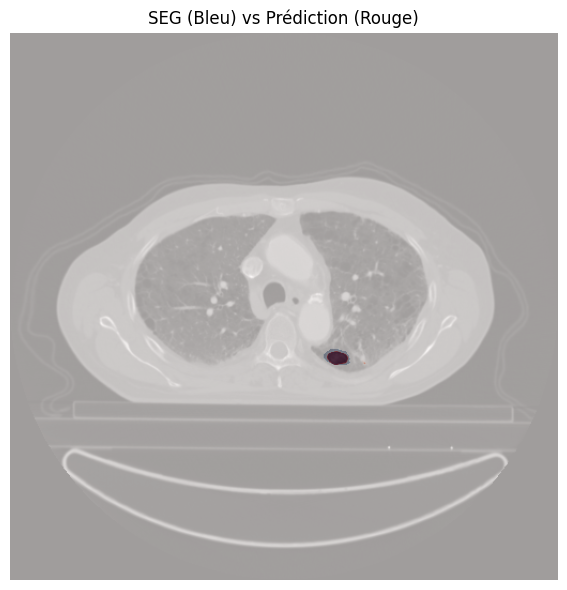

1


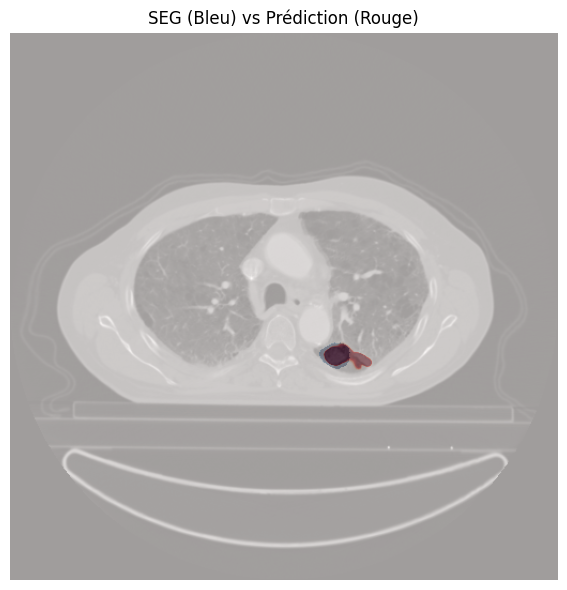

2


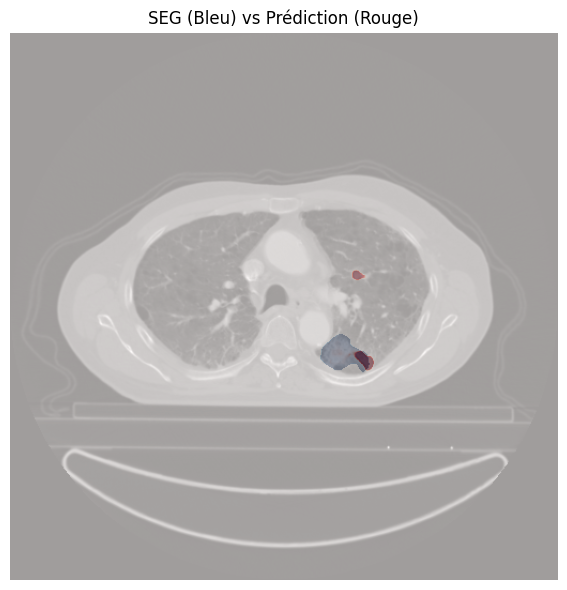

3


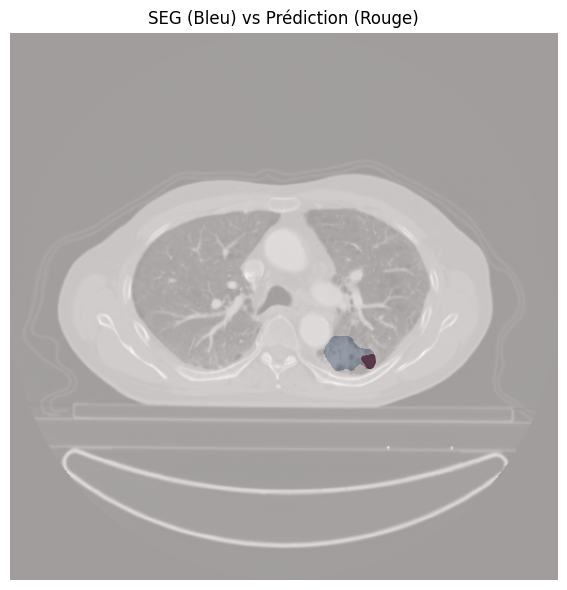

4


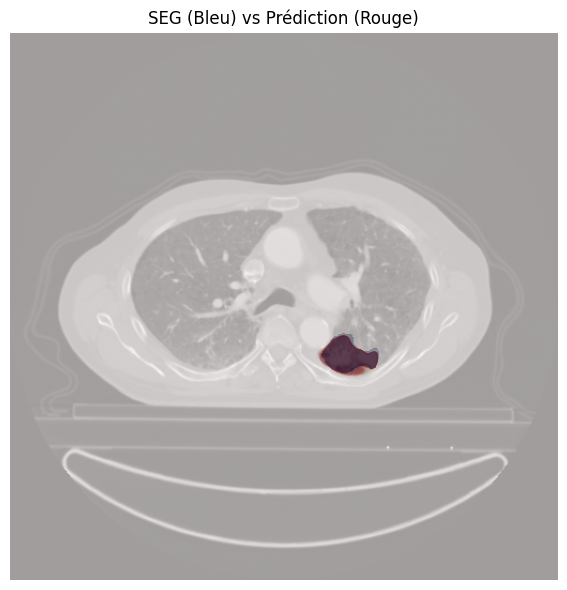

5


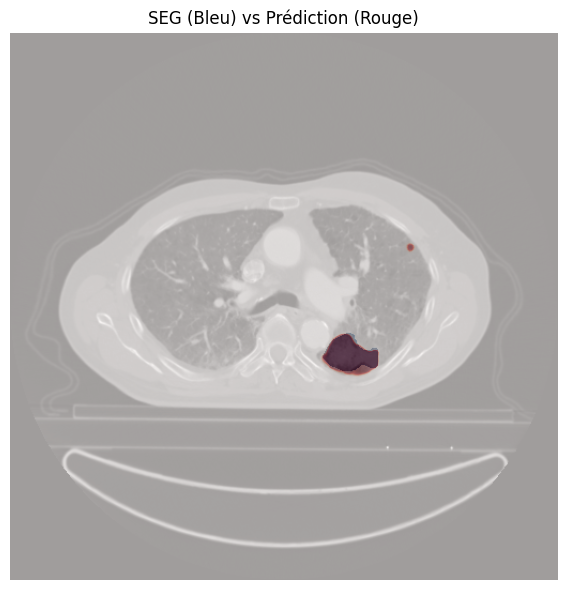

6


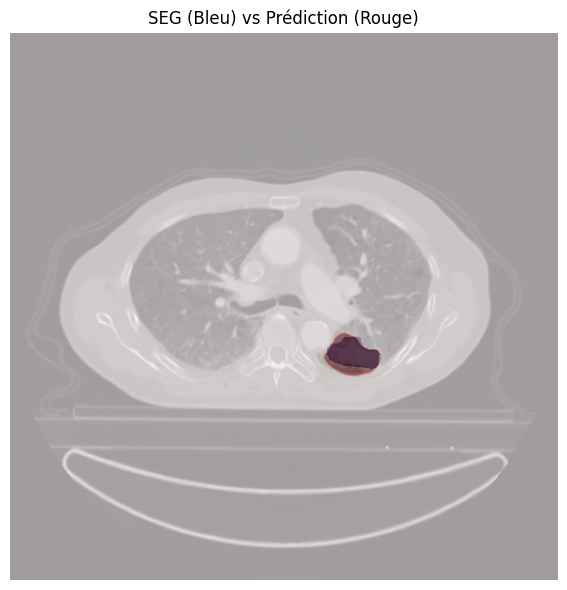

7


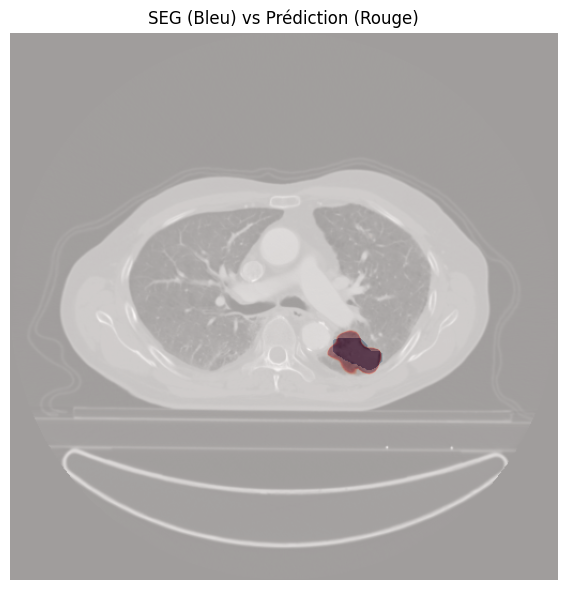

8


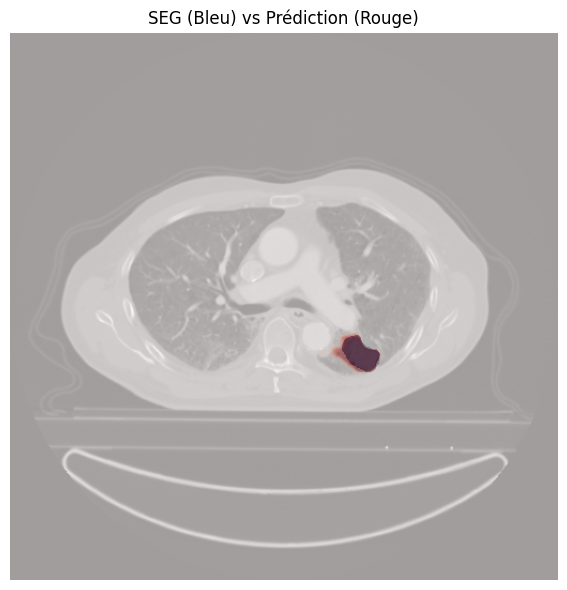

9


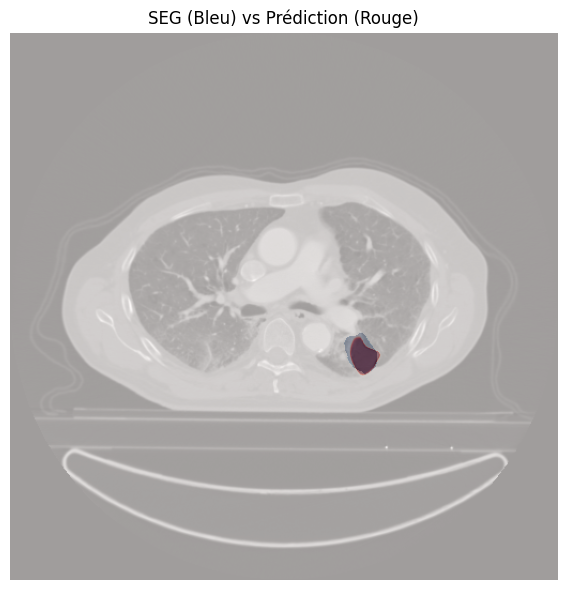

10


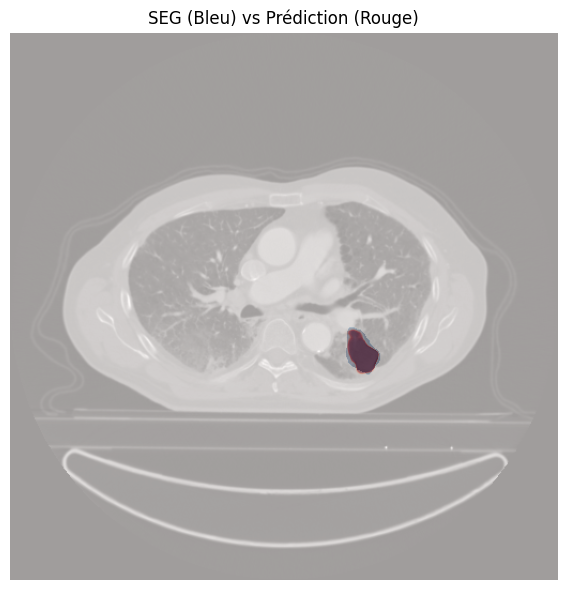

11


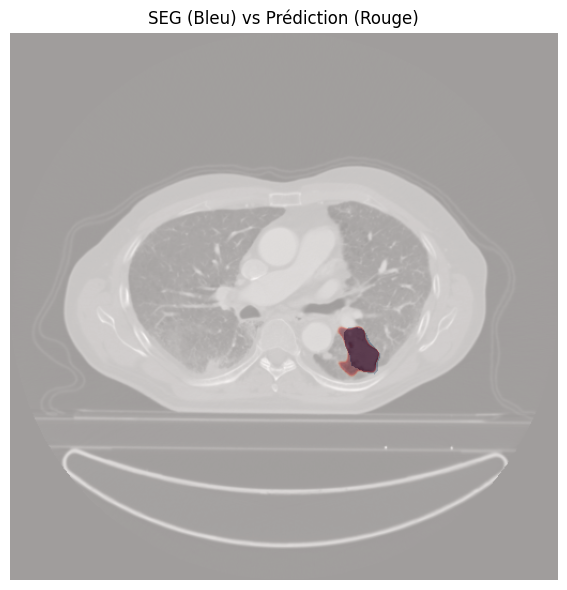

12


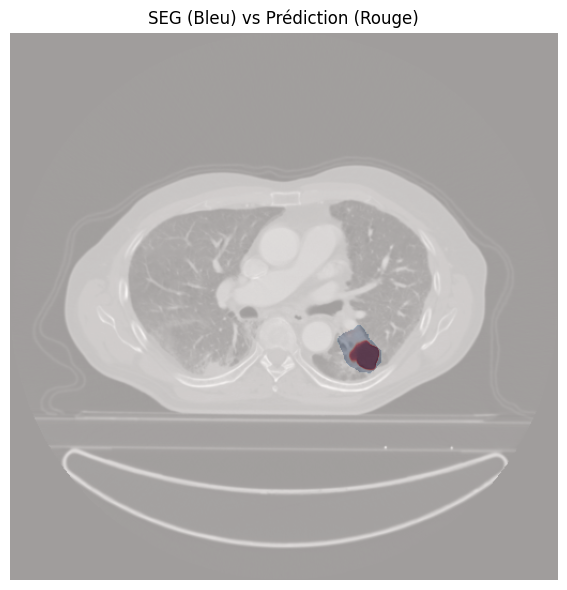

13


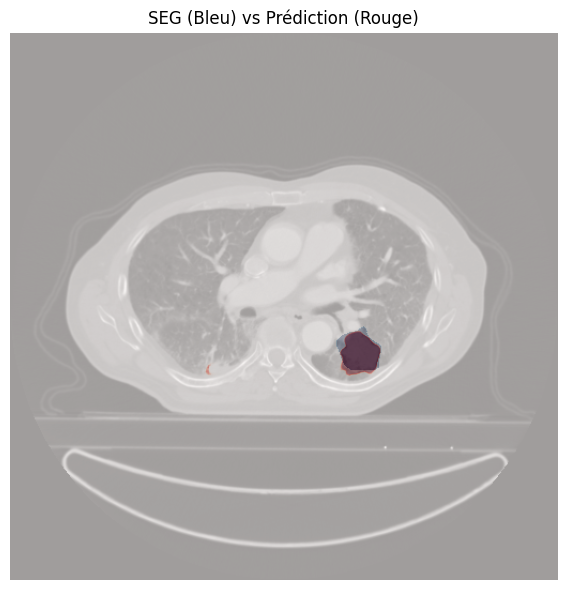

14


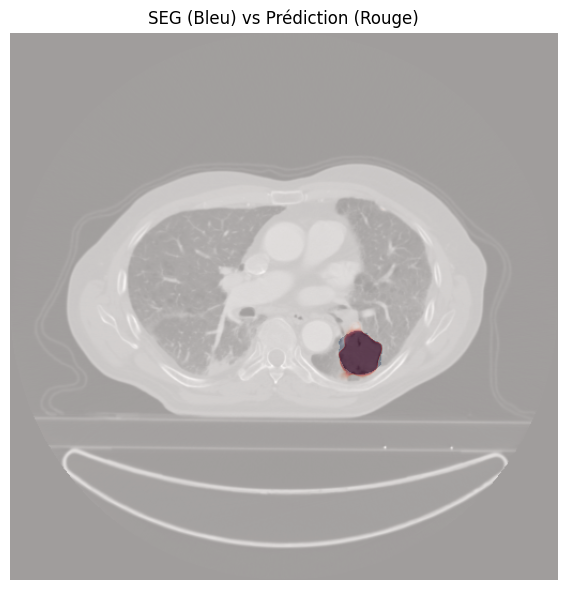

15


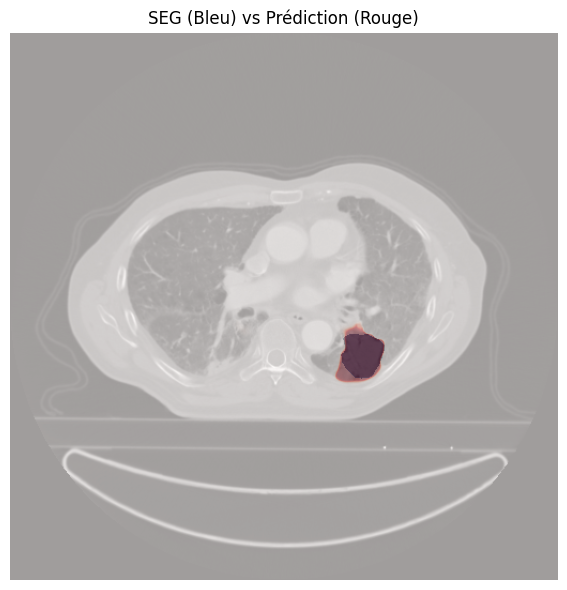

16


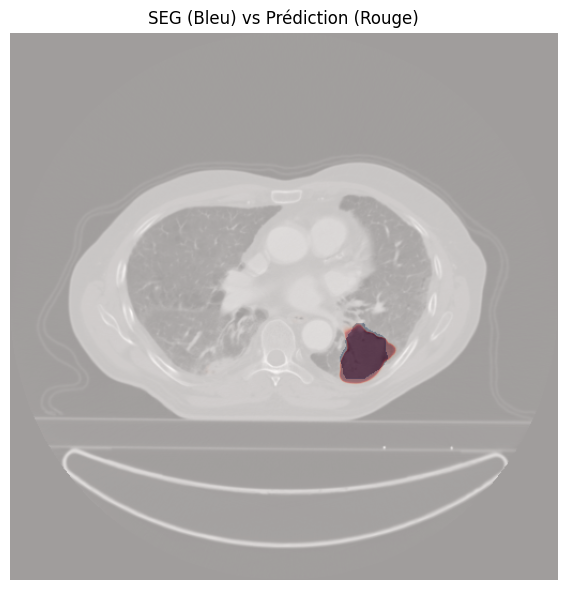

17


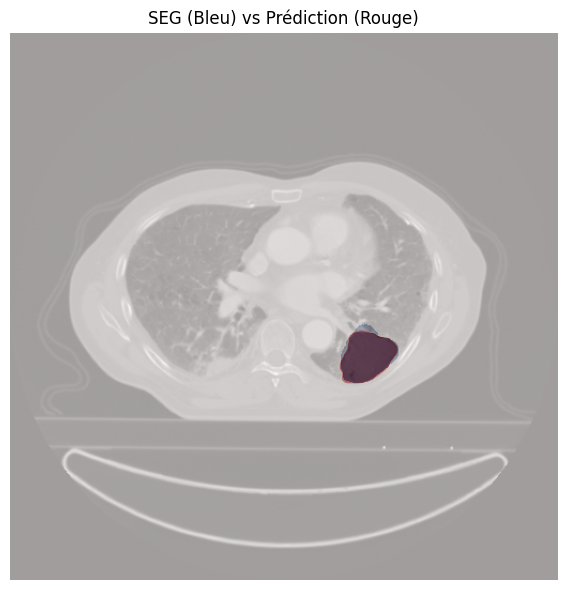

18


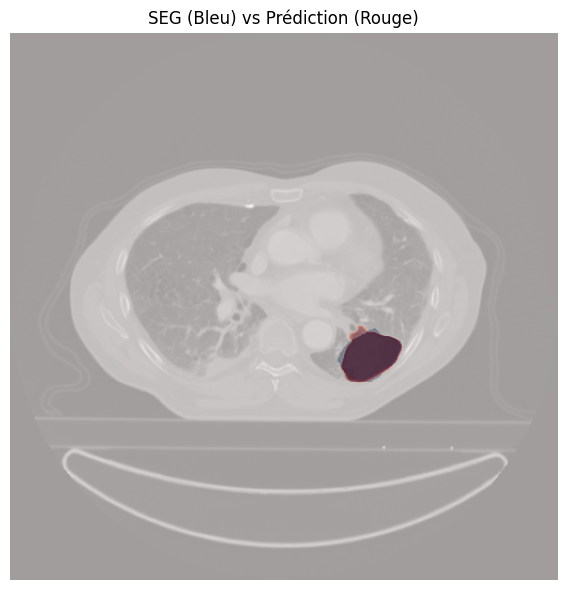

19


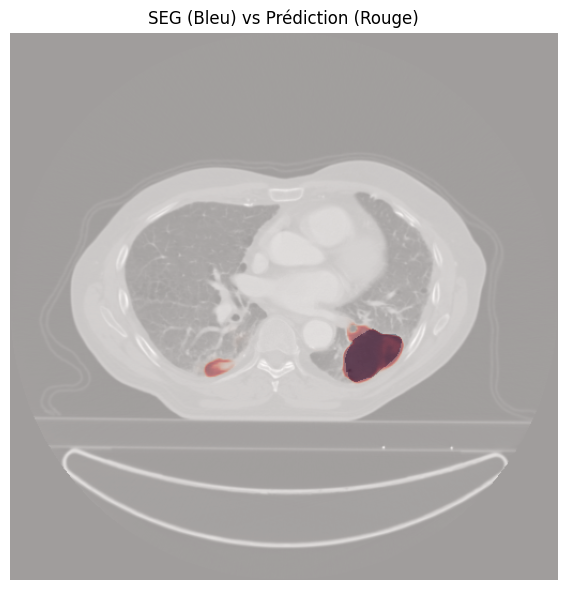

20


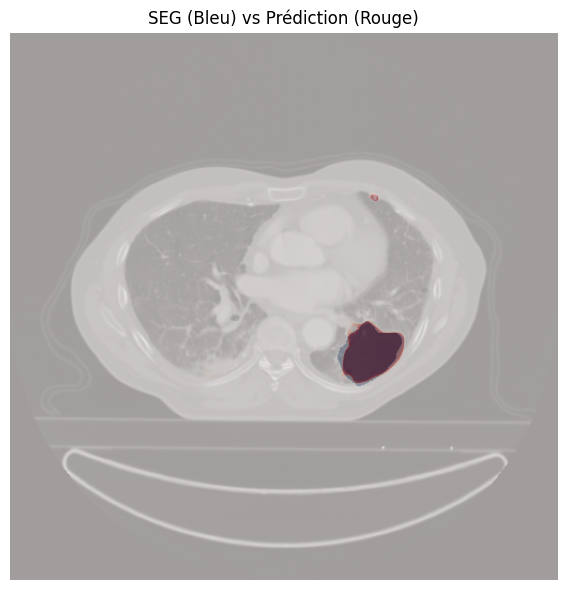

21


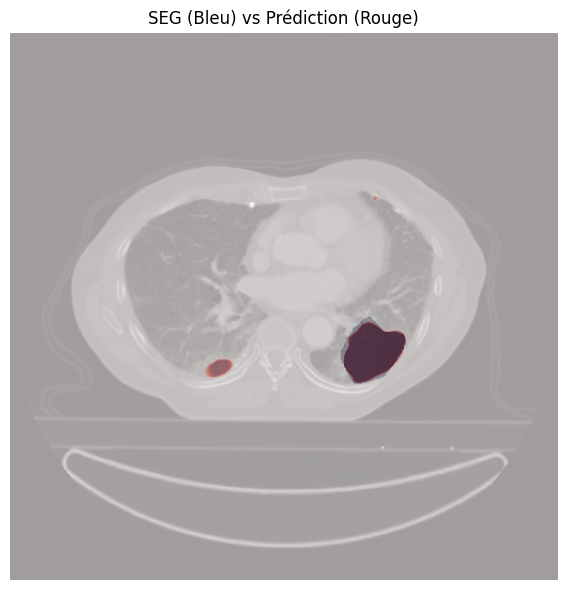

22


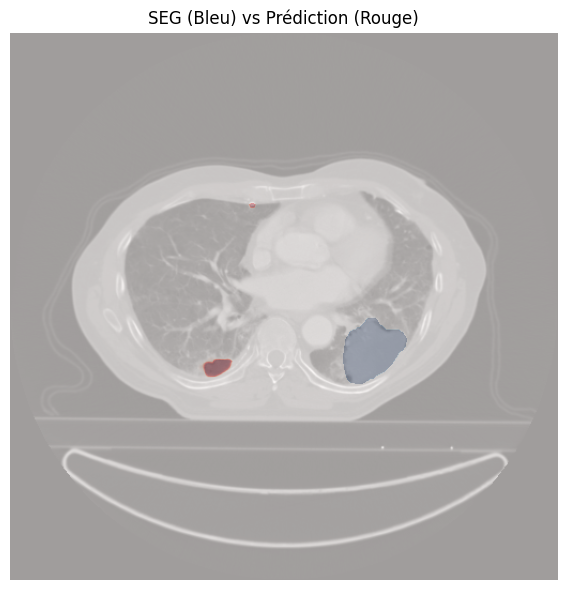

23


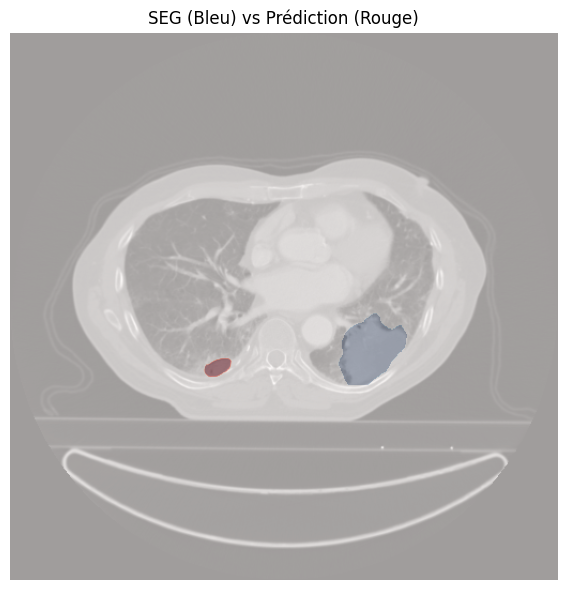

24


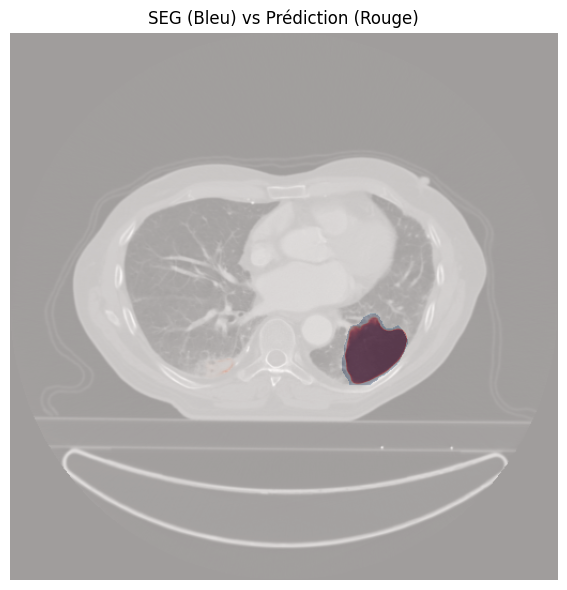

25


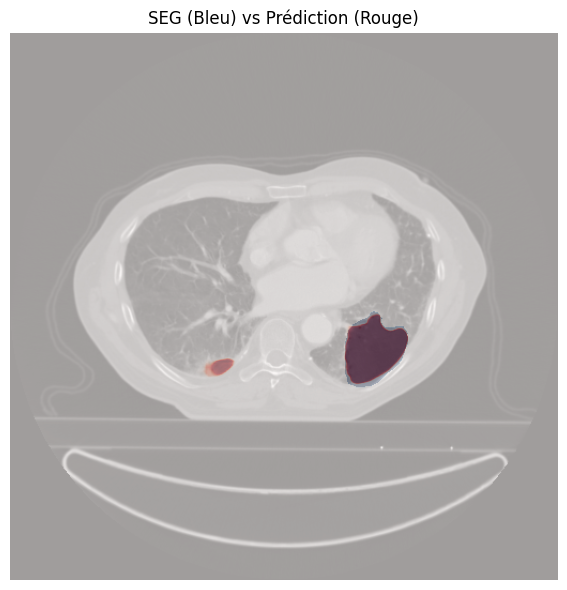

26


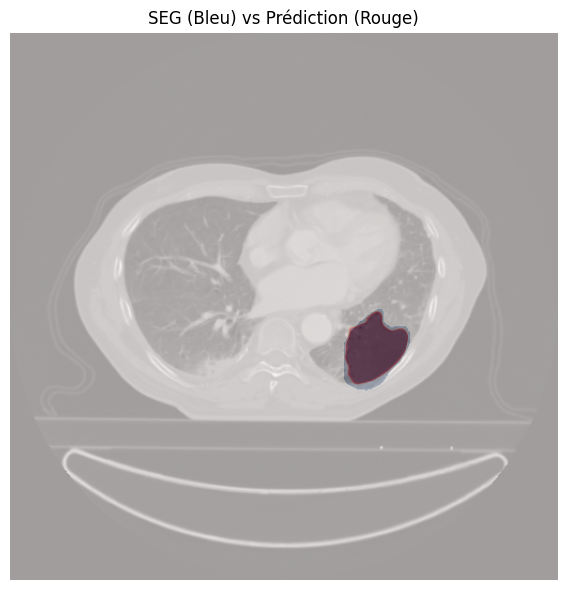

27


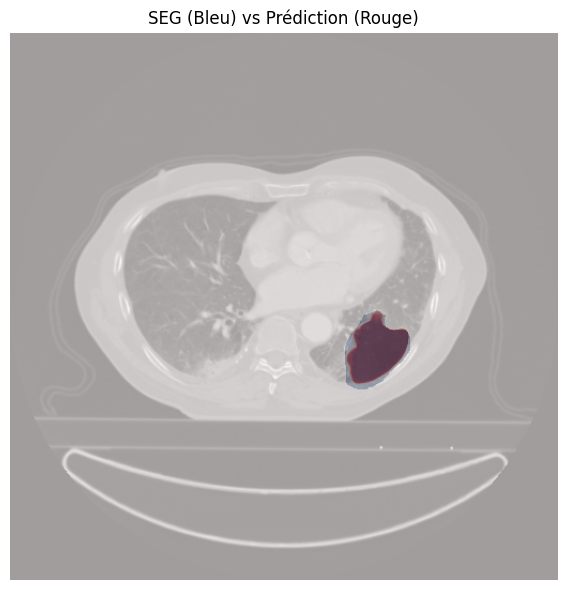

28


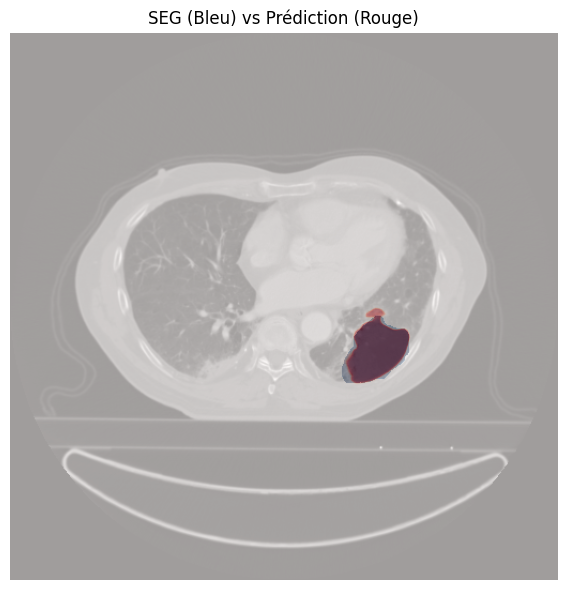

29


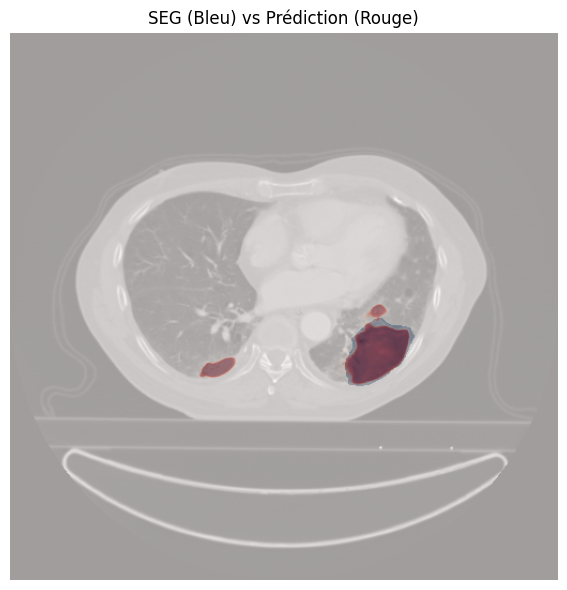

30


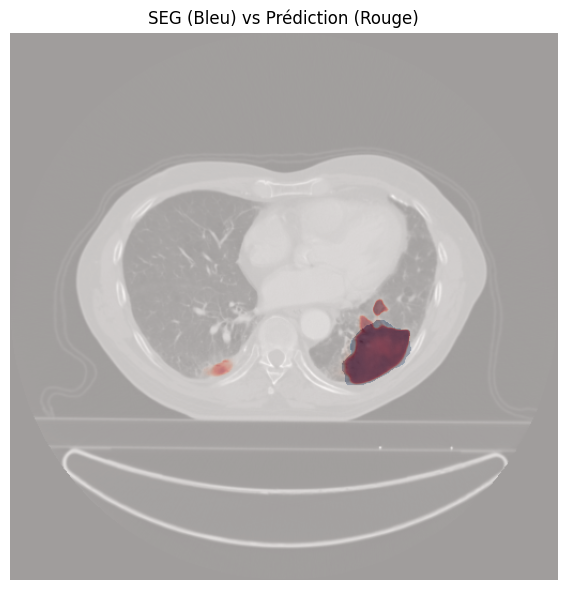

31


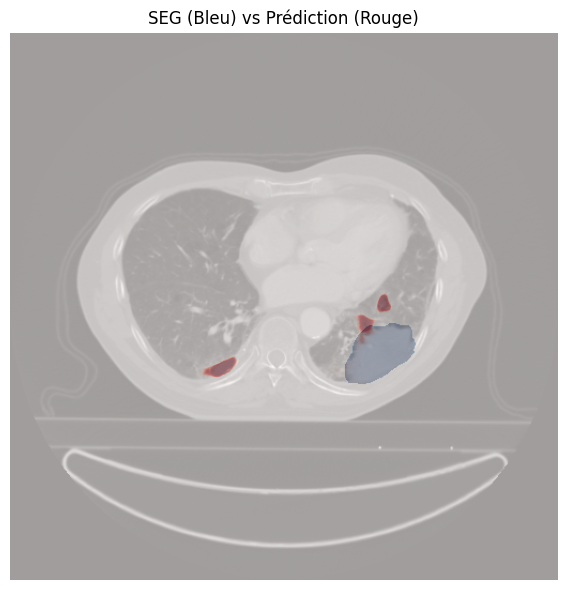

32


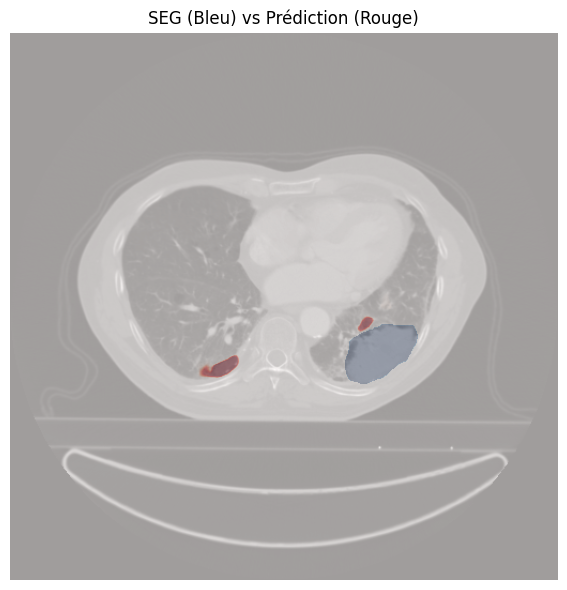

33


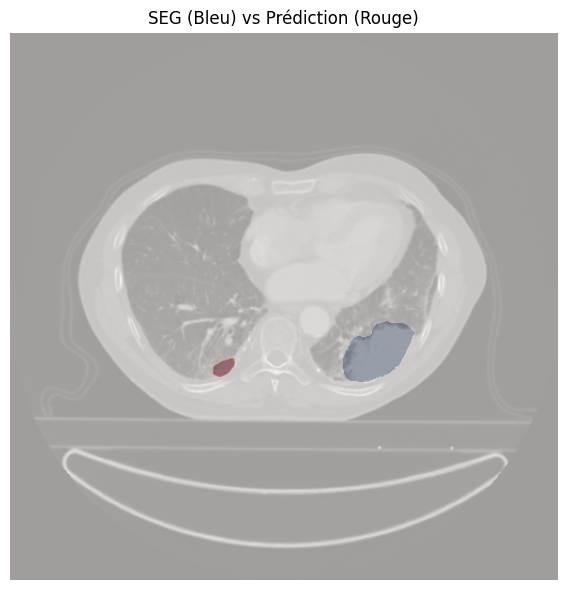

34


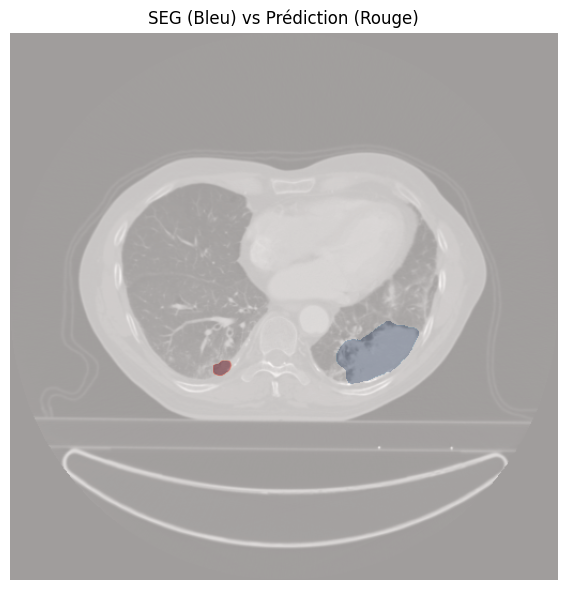

35


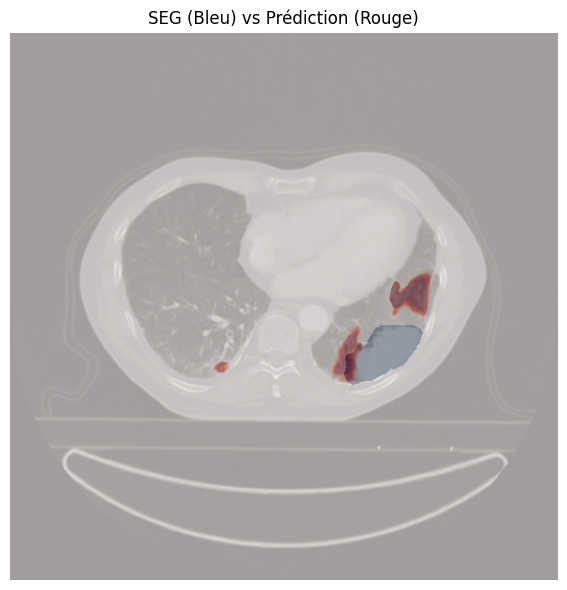

36


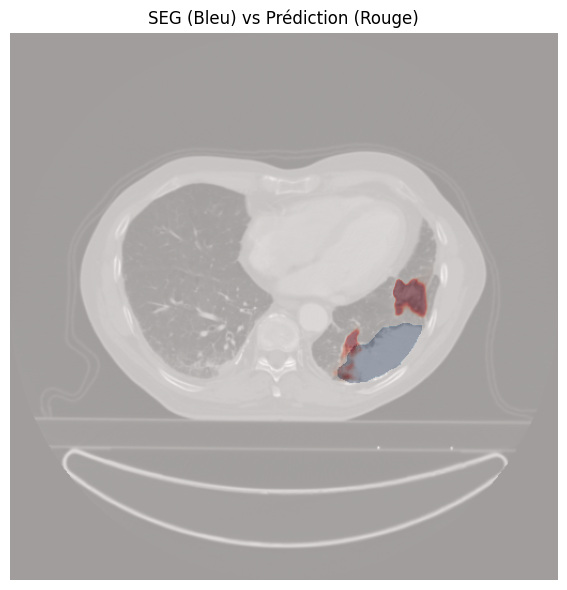

37


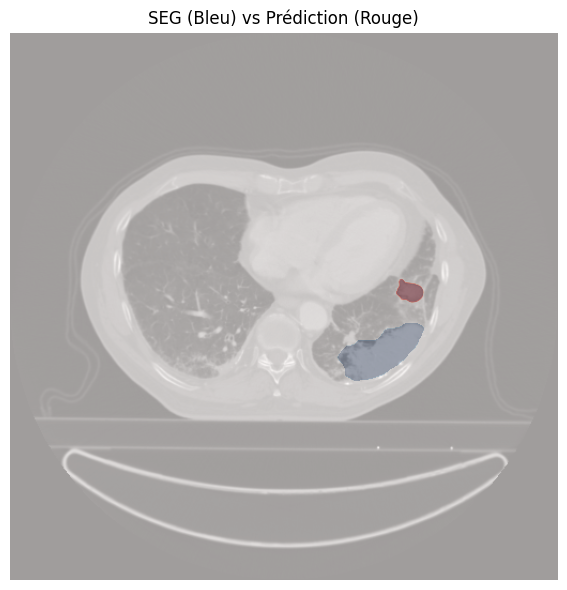

38


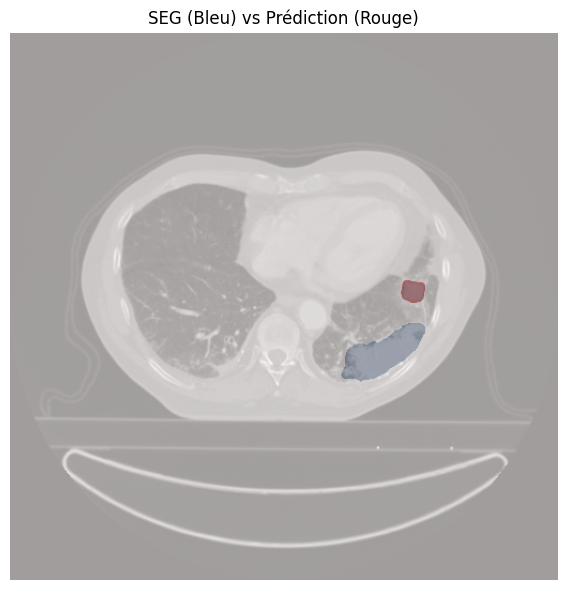

39


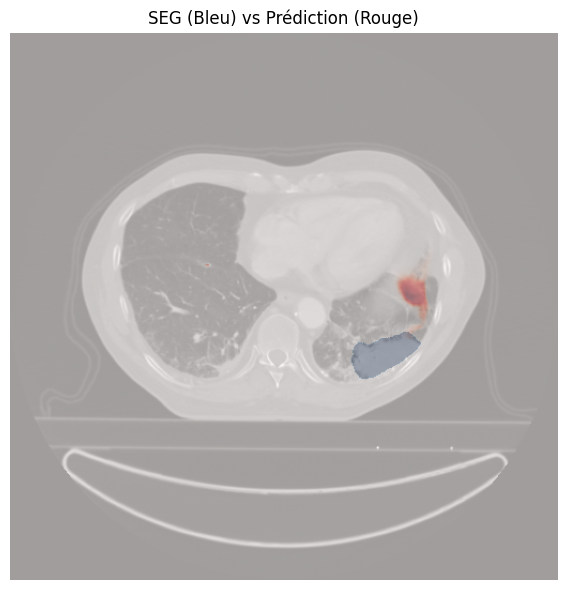

40


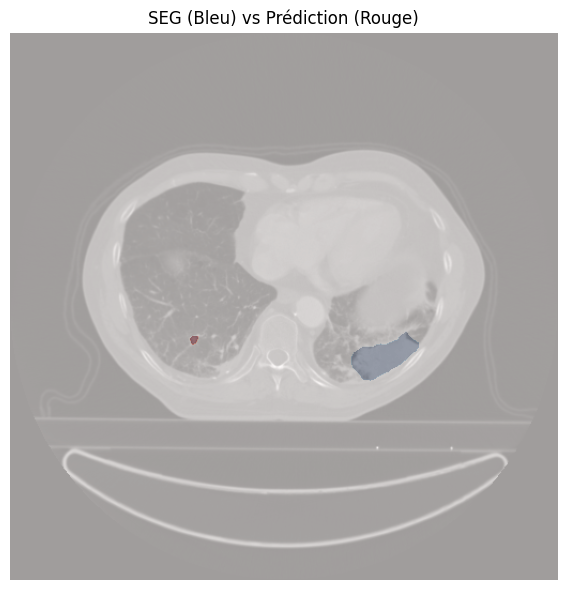

41


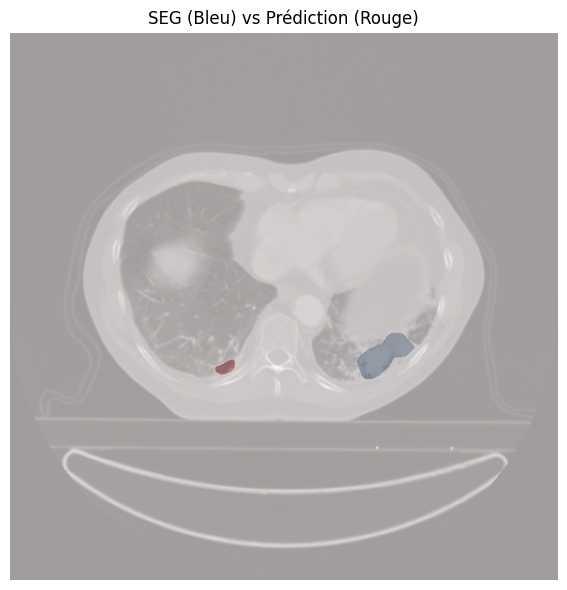

42


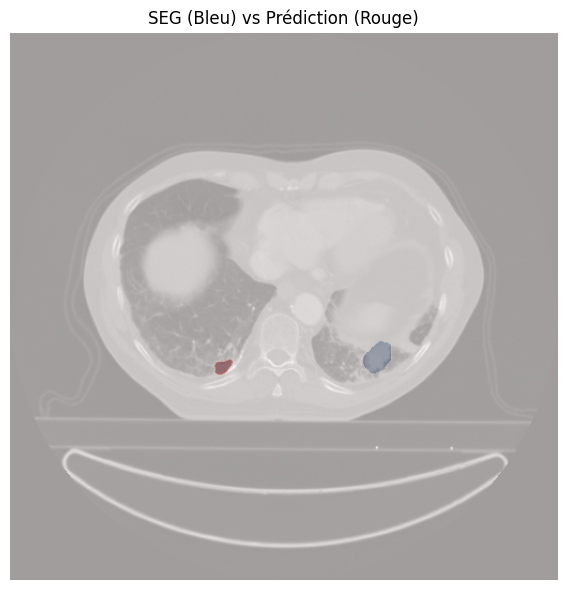

43


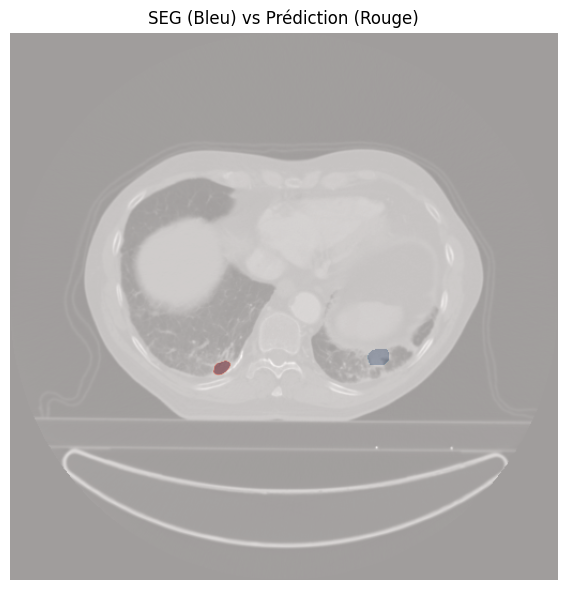

In [13]:
import random as rd 

# patient = rd.randint(0,66)
patient = 42
print(patient)
masks = call.showInference(patient, model)

In [14]:
import numpy as np

segMasks = []

for i in range(len(masks)):
    binary_mask = (masks[i][1] > 0.5).astype(np.uint8)
    segMasks.append(binary_mask)

In [15]:
weightedMask = np.sum(segMasks, axis=0) / len(segMasks)

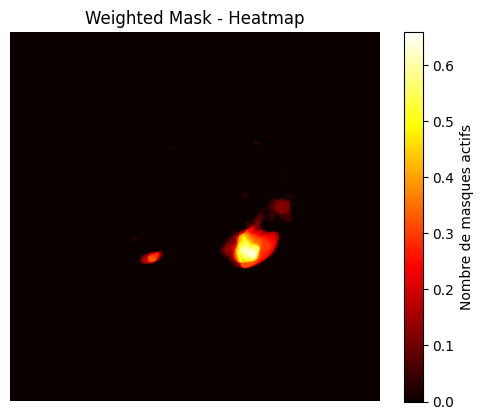

In [16]:
import matplotlib.pyplot as plt

plt.imshow(weightedMask, cmap='hot')
plt.colorbar(label='Nombre de masques actifs')
plt.title('Weighted Mask - Heatmap')
plt.axis('off') 
plt.show()

On calcule les coordonnées du barycentre de la façon suivante :

$$
\bar{x} = \frac{\sum_{i=0}^{H-1} \sum_{j=0}^{W-1} j \cdot \text{weightedMask}[i][j]}{\sum_{i=0}^{H-1} \sum_{j=0}^{W-1} \text{weightedMask}[i][j]}
$$

$$
\bar{y} = \frac{\sum_{i=0}^{H-1} \sum_{j=0}^{W-1} i \cdot \text{weightedMask}[i][j]}{\sum_{i=0}^{H-1} \sum_{j=0}^{W-1} \text{weightedMask}[i][j]}
$$

In [17]:
xb, yb = 0, 0

for i in range(len(weightedMask)):
    for j in range(len(weightedMask[0])):
        xb += weightedMask[i][j] * j
        yb += weightedMask[i][j] * i

xb = xb / np.sum(weightedMask)
yb = yb / np.sum(weightedMask)


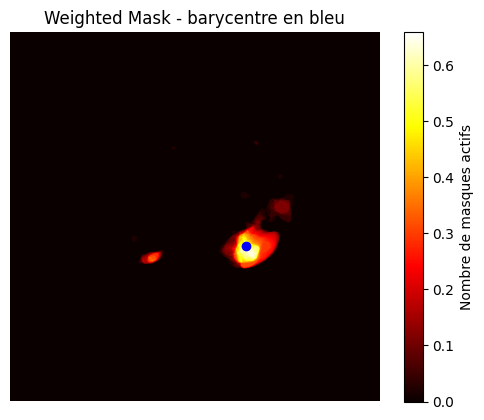

In [18]:
plt.scatter(xb, yb, c = 'blue')
plt.imshow(weightedMask, cmap='hot')
plt.colorbar(label='Nombre de masques actifs')
plt.title('Weighted Mask - barycentre en bleu')
plt.axis('off') 
plt.show()

On cherche maintenant un rectangle dont le centre est le barycentre qu'on vient de trouver, tel que la plus part des pixels "importants" sont à l'interieur.

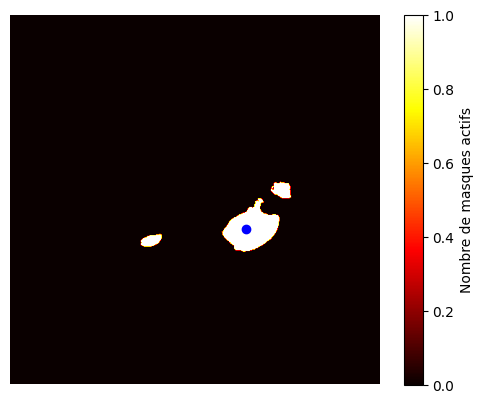

In [19]:
strong = (weightedMask > np.max(weightedMask)/10).astype(np.uint8) 
plt.scatter(xb, yb, c = 'blue')
plt.imshow(strong, cmap='hot')
plt.colorbar(label='Nombre de masques actifs')
plt.axis('off') 
plt.show()

<pre>
    +---------------------------+
    |      |                    |
    |      |y1                  |
    |      |                    |
    |  x1  |        x2          |
    |------*--------------------|
    |      |y2                  |
    +---------------------------+
</pre>
<p>Le rectangle contient tous les pixel de <code>strong</code>.</p>

In [20]:
limx = int(np.minimum(len(weightedMask) - xb, xb))
limy = int(np.minimum(len(weightedMask) - yb, yb))
intxb, intyb = int(xb), int(yb)
# x1
x1 = 0
for p in range(limx):
    lst = []
    for y in range(len(strong)):
        if strong[y][intxb-p] == 1:
            lst.append((y, xb-p))
    if len(lst) == 0:
        x1 = xb-p
        break 

# x2
x2 = 0
for p in range(limx):
    lst = []
    for y in range(len(strong)):
        if strong[y][intxb+p] == 1:
            lst.append((y, xb-p))
    if len(lst) == 0:
        x2 = xb+p
        break 

# y1
y1 = 0
for p in range(limy):
    lst = []
    for x in range(len(strong[0])):
        if strong[intyb-p][x] == 1:
            lst.append((intyb, x))
    if len(lst) == 0:
        y1 = yb-p
        break 

# y2
y2 = 0
for p in range(limy):
    lst = []
    for x in range(len(strong[0])):
        if strong[intyb+p][x] == 1:
            lst.append((intyb, x))
    if len(lst) == 0:
        y2 = yb+p
        break 
    

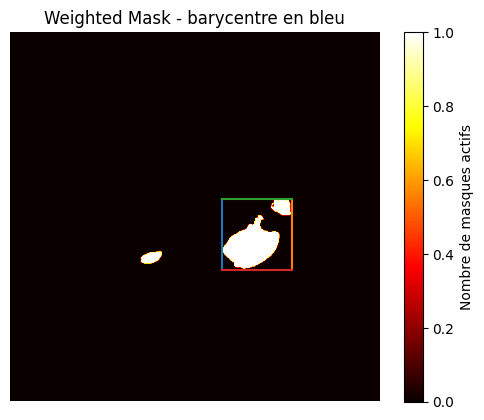

In [21]:
plt.plot([x1,x1], [y1, y2])
plt.plot([x2,x2], [y2, y1])
plt.plot([x1,x2], [y1, y1])
plt.plot([x2,x1], [y2, y2])
plt.imshow(strong, cmap='hot')
plt.colorbar(label='Nombre de masques actifs')
plt.title('Weighted Mask - barycentre en bleu')
plt.axis('off') 
plt.show()

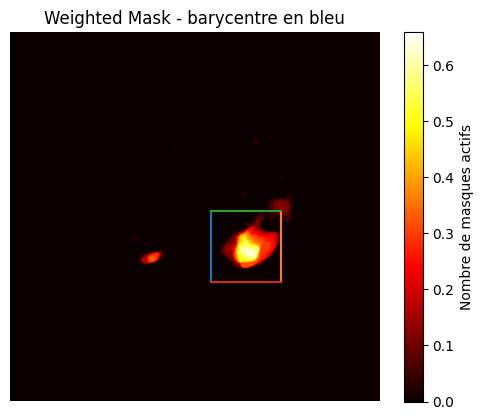

In [ ]:
# x1 = x1 / 1.1
# x2 = x2 * 1.1
# y1 = y1 / 1.1
# y2 = y2 * 1.1

# On recentre la bounding box sur le barycentre
# dx = xb - (x1 + x2) / 2
# dy = yb - (y1 + y2) / 2

# x1 += dx
# x2 += dx
# y1 += dy
# y2 += dy

# Tracé du rectangle
plt.plot([x1,x1], [y1, y2])
plt.plot([x2,x2], [y2, y1])
plt.plot([x1,x2], [y1, y1])
plt.plot([x2,x1], [y2, y2])
plt.imshow(weightedMask, cmap='hot')
plt.colorbar(label='Nombre de masques actifs')
plt.title('Weighted Mask - barycentre en bleu')
plt.axis('off') 
plt.show()



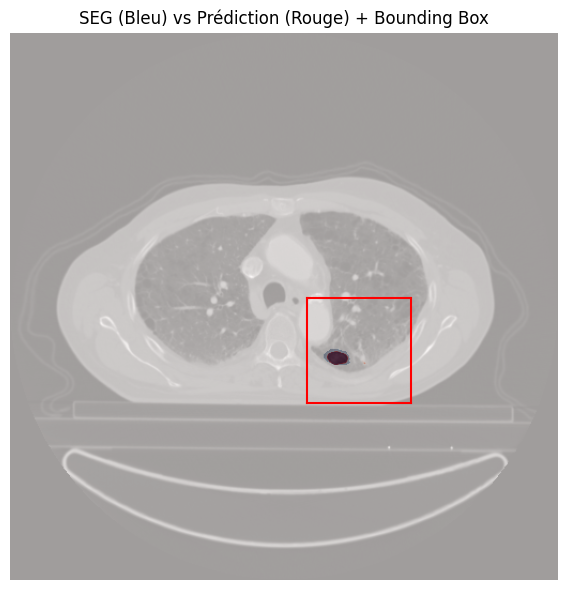

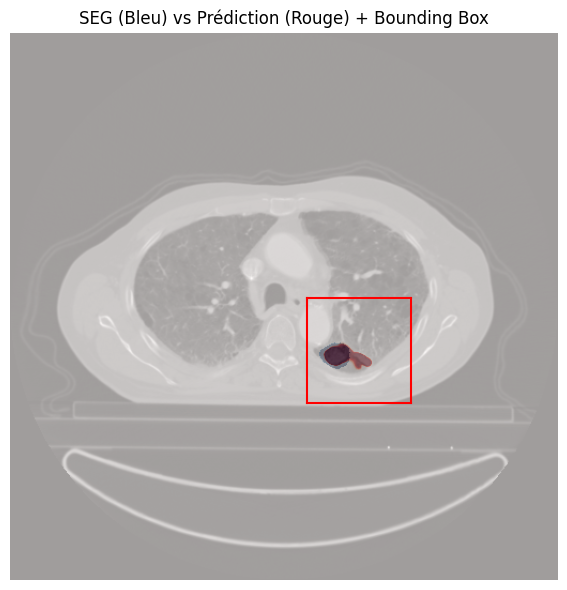

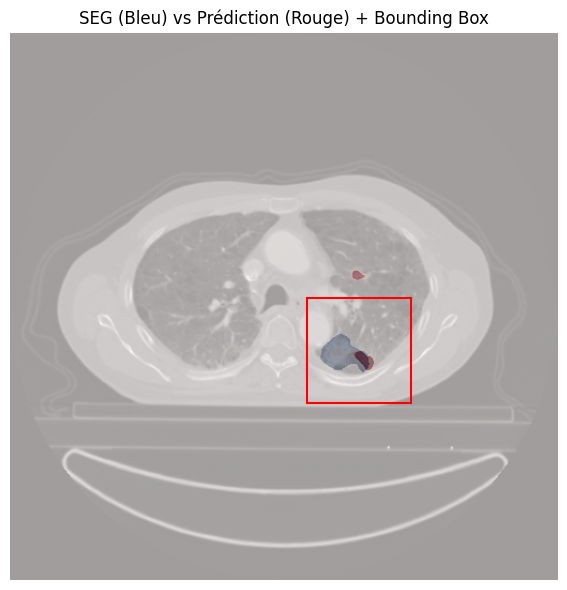

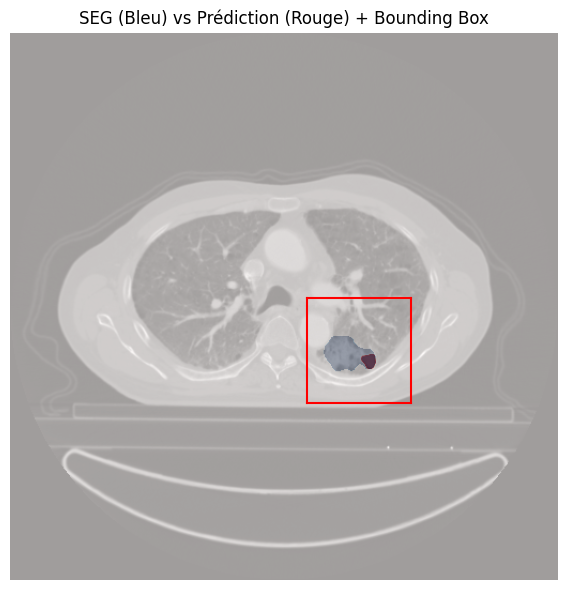

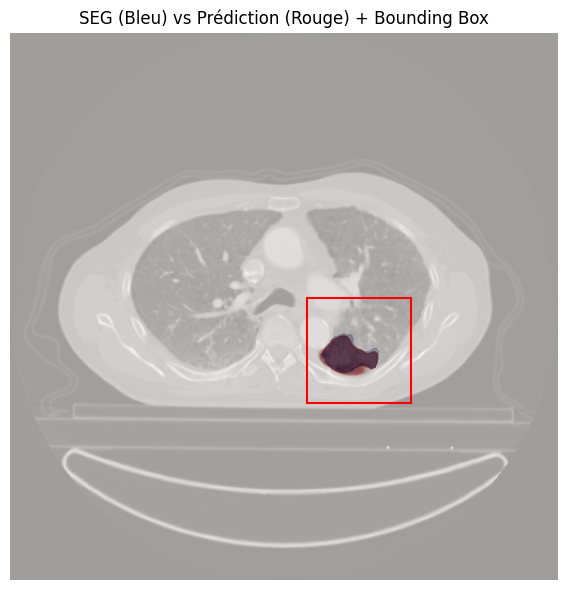

...

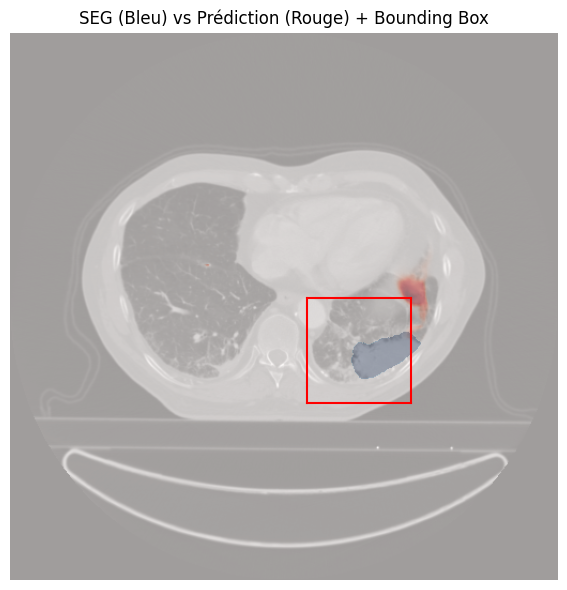

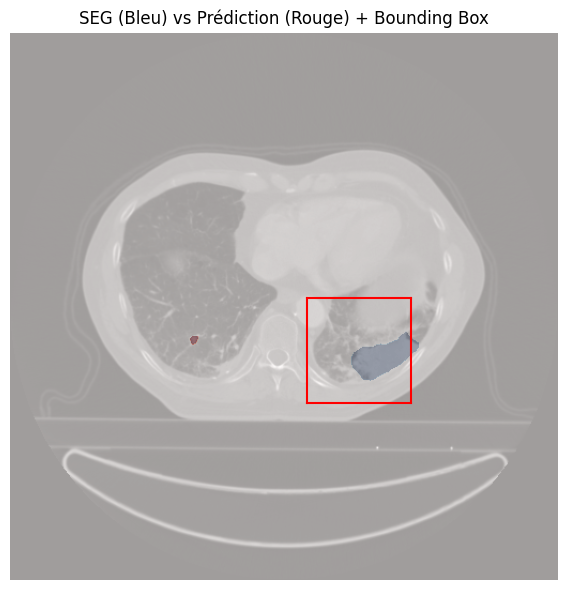

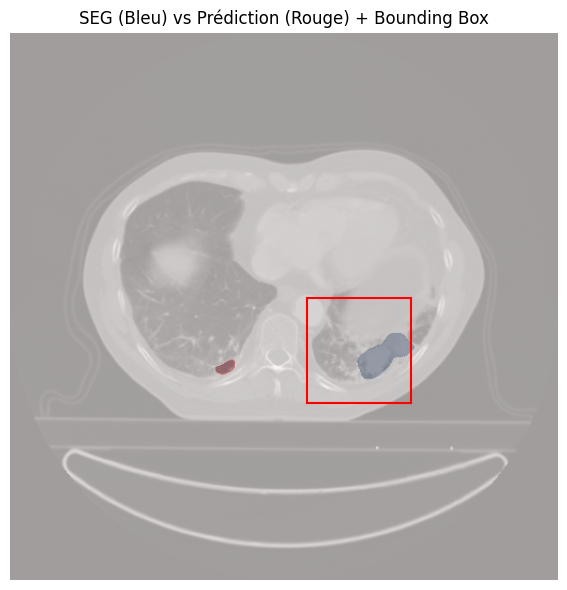

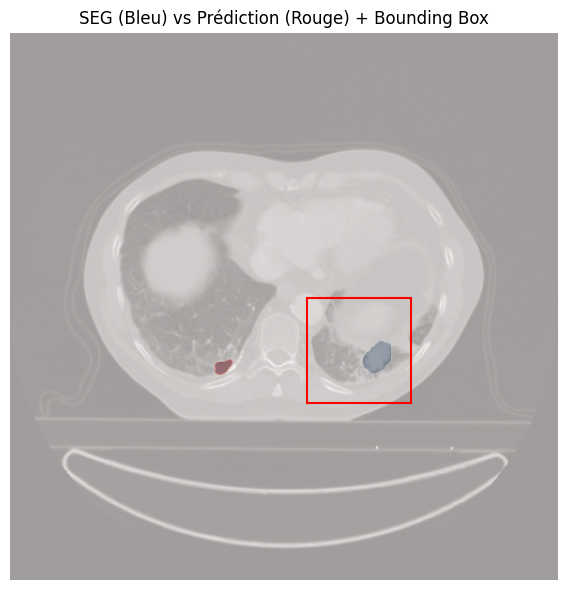

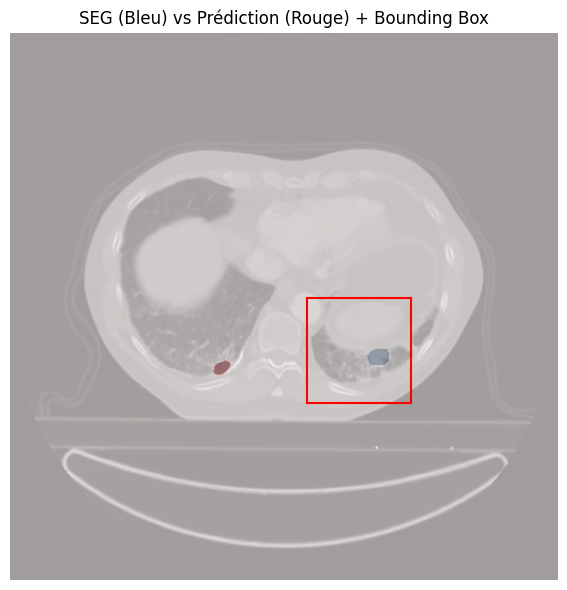

[[array([[-1024, -1024, -1024, ..., -1024, -1024, -1024],
         [-1024, -1024, -1024, ..., -1024, -1024, -1024],
         [-1024, -1024, -1024, ..., -1024, -1024, -1024],
         ...,
         [-1024, -1024, -1024, ..., -1024, -1024, -1024],
         [-1024, -1024, -1024, ..., -1024, -1024, -1024],
         [-1024, -1024, -1024, ..., -1024, -1024, -1024]], dtype=int16),
  array([[1.80621740e-10, 2.45798902e-11, 8.42984807e-15, ...,
          1.09843146e-23, 2.12638422e-19, 3.48974213e-16],
         [3.02733116e-11, 3.21108981e-12, 4.06462021e-16, ...,
          1.26294548e-25, 1.04097182e-20, 5.06382832e-17],
         [2.38902289e-14, 9.35279593e-16, 2.19697111e-21, ...,
          2.20712160e-33, 5.97899189e-26, 2.24504315e-20],
         ...,
         [3.38335595e-23, 2.87453716e-25, 1.49777220e-33, ...,
          0.00000000e+00, 2.63356983e-33, 6.61160595e-26],
         [8.36059207e-19, 2.49115797e-20, 1.96361593e-26, ...,
          5.08989008e-34, 1.33497406e-26, 4.89269214e-21],

In [66]:
import G_inferenceCall as call
vect = (x1, x2, y1, y2)
call.showBoundingBox(patient, model, vect)


### Test sur tous les patients

In [1]:
import G_inferenceCall as call
import pandas as pd
import numpy as np
import os

model = call.getModel()

[SRV-ML03:2482071] shmem: mmap: an error occurred while determining whether or not /tmp/ompi.SRV-ML03.476685808/jf.0/3512795136/shared_mem_cuda_pool.SRV-ML03 could be created.
[SRV-ML03:2482071] create_and_attach: unable to create shared memory BTL coordinating structure :: size 134217728 
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/kornia/feature/lightglue.py:30: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(


Deformable Transformer Encoder is not available.
➡️  Type de tokenizer : clip
➡️  Chemin/tokenizer utilisé : ./local-tokenizer/clip-vit-base-patch32
➡️  Contenu complet config_encoder : {'ARCH': 'vlpencoder', 'NAME': 'transformer', 'TOKENIZER': 'clip', 'PRETRAINED_TOKENIZER': './local-tokenizer/clip-vit-base-patch32', 'CONTEXT_LENGTH': 77, 'WIDTH': 512, 'HEADS': 8, 'LAYERS': 12, 'AUTOGRESSIVE': True}
✅ Tokenizer FINAL utilisé: ./local-tokenizer/clip-vit-base-patch32


/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/modeling_utils.py:484: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explici

In [2]:
# TODO : ajouter une focntion pour filtrer les masques 


# on utilise getMask pour récupérer tous les mask gt et toutes les prédictions
# puis on fait tourner le code pour obtenir une bounding box pour chaque masque
# on regarde en moyenne la proportion du gt contenu dans la bounding box
masks = call.getMasks(model)
    
        

Nombre de cas où ça n'a pas du tout fonctionné : 482
Proportion d'anglobement moyen par patient pour les autre cas : 0.8777389413907586
Proportion d'anglobement moyen : 0.5957957394628821


/tmp/ipykernel_2482071/3465921550.py:127: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([prop, propOk], labels=['Tous les cas', 'Cas réussis (>0)'])


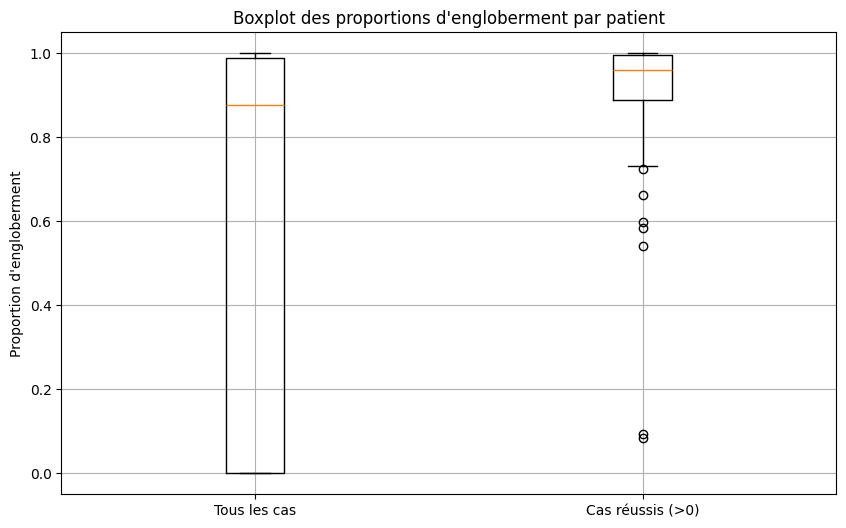

In [29]:
# masks = predicted_masks, ground_truth_masks
# print(len(masks[0][0]) == len(os.listdir('test/dcm/0/0/'))) => True 
import matplotlib.pyplot as plt

def isInBB(bb,coord):
    x1,x2,y1,y2 = bb 
    l,c = coord

    if l > y1 and c > x1 and c < x2 and l < y2 :
        return True
    
    return False

prop = []
propOk = []
z = []
for i in range(len(masks[0])):
    segMasks = []

    for j in range(len(masks[0][i])):
        binary_mask = (masks[0][i][j] > 0.5).astype(np.uint8)
        segMasks.append(binary_mask)

    weightedMask = np.sum(segMasks, axis=0) / len(segMasks)
    
    xb, yb = 0, 0

    for k in range(len(weightedMask)):
        for j in range(len(weightedMask[0])):
            xb += weightedMask[k][j] * j
            yb += weightedMask[k][j] * k

    xb = xb / np.sum(weightedMask)
    yb = yb / np.sum(weightedMask)

    strong = (weightedMask > np.max(weightedMask)/10).astype(np.uint8) 

    limx = int(np.minimum(len(weightedMask) - xb, xb))
    limy = int(np.minimum(len(weightedMask) - yb, yb))
    intxb, intyb = int(xb), int(yb)

    # x1
    x1 = 0
    for p in range(limx):
        lst = []
        for y in range(len(strong)):
            if strong[y][intxb-p] == 1:
                lst.append((y, xb-p))
        if len(lst) == 0:
            x1 = xb-p
            break 

    # x2
    x2 = 0
    for p in range(limx):
        lst = []
        for y in range(len(strong)):
            if strong[y][intxb+p] == 1:
                lst.append((y, xb-p))
        if len(lst) == 0:
            x2 = xb+p
            break 

    # y1
    y1 = 0
    for p in range(limy):
        lst = []
        for x in range(len(strong[0])):
            if strong[intyb-p][x] == 1:
                lst.append((intyb, x))
        if len(lst) == 0:
            y1 = yb-p
            break 

    # y2
    y2 = 0
    for p in range(limy):
        lst = []
        for x in range(len(strong[0])):
            if strong[intyb+p][x] == 1:
                lst.append((intyb, x))
        if len(lst) == 0:
            y2 = yb+p
            break 

    dx = xb - (x1 + x2) / 2
    dy = yb - (y1 + y2) / 2

    # x1 += dx
    # x2 += dx
    # y1 += dy
    # y2 += dy

    bb = x1,x2,y1,y2

    # on a obtenu la BoundingBox. On va maintenant parcourir tous les pixels de tous les masques gt et vérifier s'ils sont dans la BB.
    # on va calculer la proportion de pixel dans la bounding box et faire une moyenne par patient et on affichera le résultat avec un box plot.

    propPat = []
    propPatOk = []
    for j in range(len(masks[1][i])) :
        # print(len(masks[1][i][0]))
        # print(f"{j} : {masks[1][i][j]}")
        maskGt = masks[1][i][j]
        tot = 0
        c = 0
        for y in range(len(maskGt)):
            for x in range(len(maskGt[0])):
                if maskGt[y][x] == 1 :
                    tot+=1
                    if isInBB(bb, (y,x)) :
                        c+=1
        if tot == 0:
            tot=1
        pp = c/tot
        if pp == 0:
            z.append(pp)
        else:
            propPatOk.append(pp)
        propPat.append(pp)
    prop.append(np.mean(propPat))
    if propPatOk : propOk.append(np.mean(propPatOk))
print(f"Nombre de cas où ça n'a pas du tout fonctionné : {len(z)}")
print(f"Proportion d'anglobement moyen par patient pour les autre cas : {np.mean(propOk)}")
print(f"Proportion d'anglobement moyen : {np.mean(prop)}")
plt.figure(figsize=(10, 6))
plt.boxplot([prop, propOk], labels=['Tous les cas', 'Cas réussis (>0)'])
plt.ylabel("Proportion d'engloberment")
plt.title("Boxplot des proportions d'engloberment par patient")
plt.grid(True)
plt.show()

        
        



In [ ]:
print(len(masks[0]))
c=0
for i in range(len(masks[0])):
    c+=len(masks[0][i])
print(c)
482/1261 * 100


63
1261


38.22363203806503

## Filtrage des masques

In [1]:
import G_inferenceCall as call
import pandas as pd
import random as rd 

model = call.getModel()

[SRV-ML03:2912935] shmem: mmap: an error occurred while determining whether or not /tmp/ompi.SRV-ML03.476685808/jf.0/2362179584/shared_mem_cuda_pool.SRV-ML03 could be created.
[SRV-ML03:2912935] create_and_attach: unable to create shared memory BTL coordinating structure :: size 134217728 
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/kornia/feature/lightglue.py:30: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(


Deformable Transformer Encoder is not available.
➡️  Type de tokenizer : clip
➡️  Chemin/tokenizer utilisé : ./local-tokenizer/clip-vit-base-patch32
➡️  Contenu complet config_encoder : {'ARCH': 'vlpencoder', 'NAME': 'transformer', 'TOKENIZER': 'clip', 'PRETRAINED_TOKENIZER': './local-tokenizer/clip-vit-base-patch32', 'CONTEXT_LENGTH': 77, 'WIDTH': 512, 'HEADS': 8, 'LAYERS': 12, 'AUTOGRESSIVE': True}
✅ Tokenizer FINAL utilisé: ./local-tokenizer/clip-vit-base-patch32


/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/modeling_utils.py:484: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explici

10
Filtré :


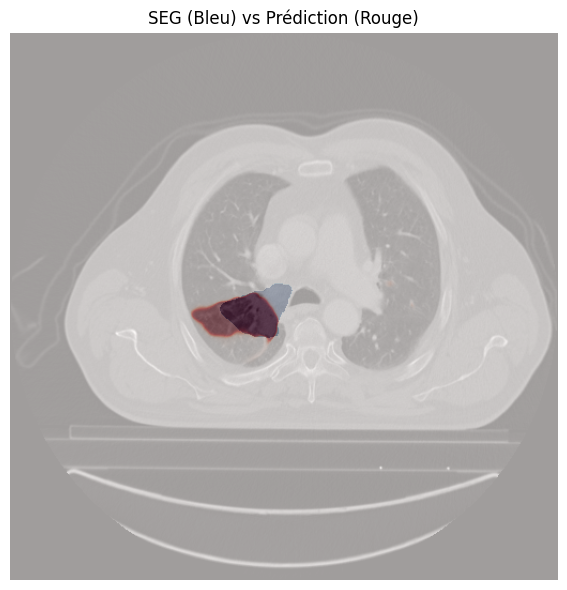

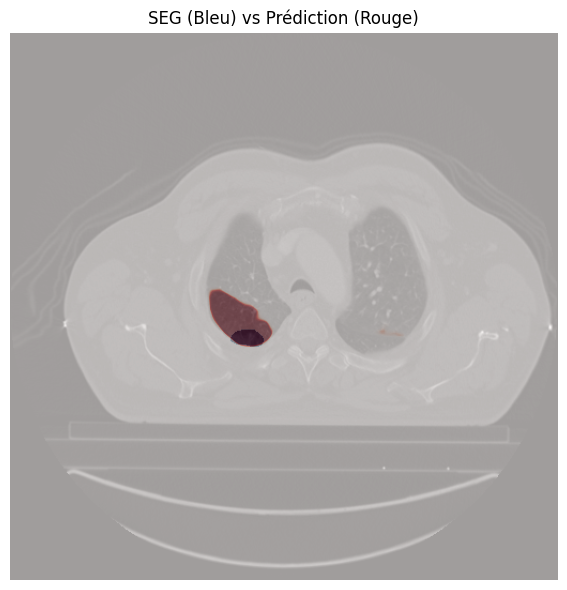

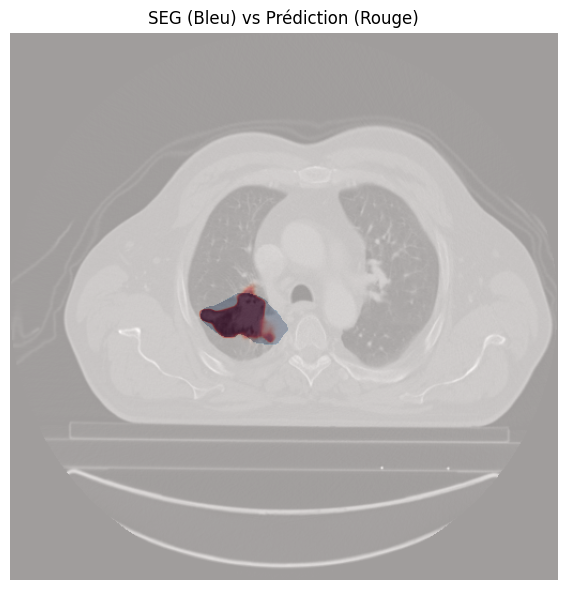

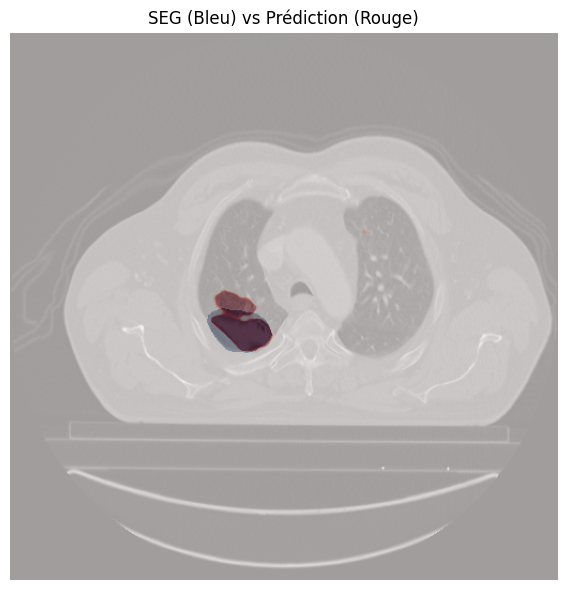

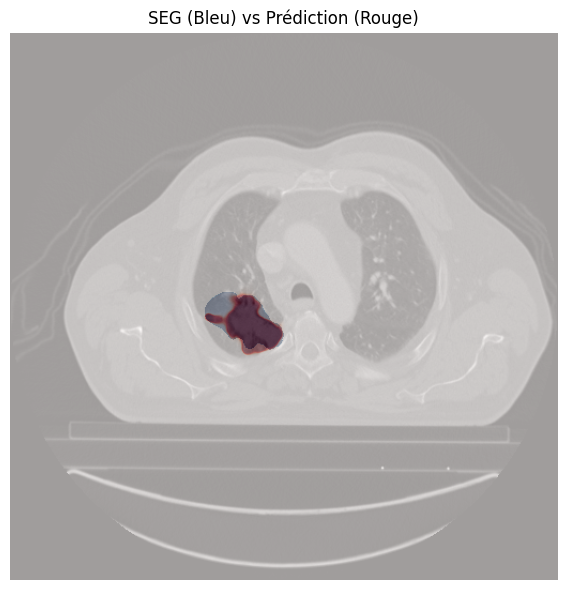

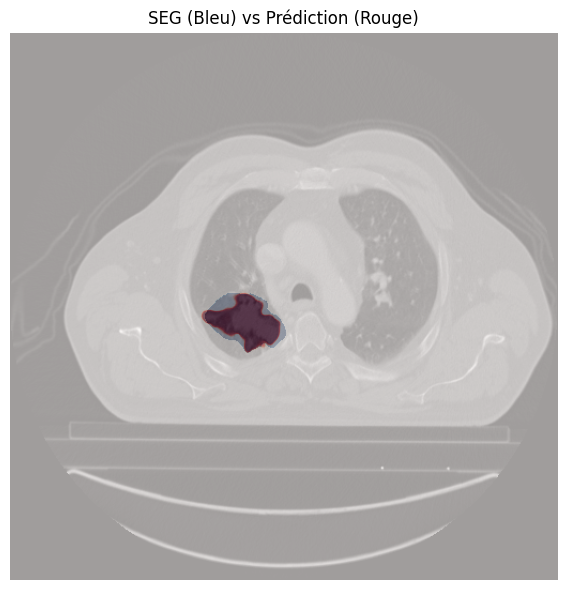

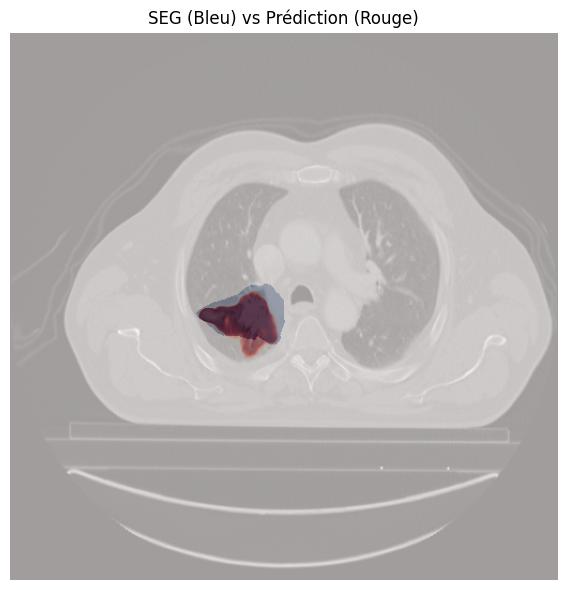

In [9]:

patient = rd.randint(0,66)
print(patient)


print("Filtré :")
masks = call.showFilteredInference(patient, model)





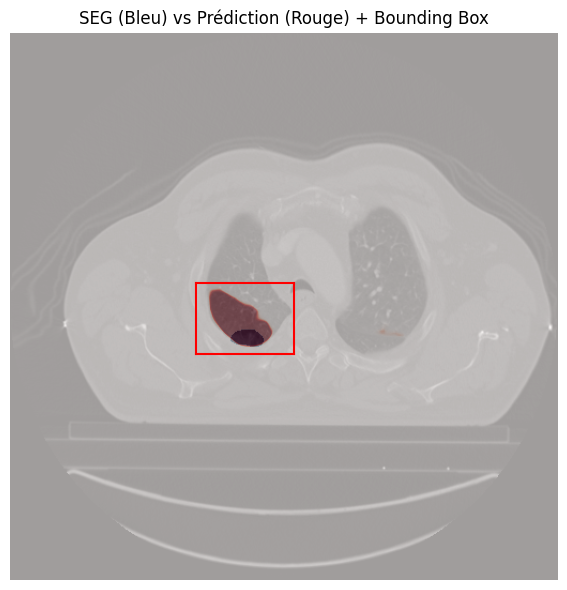

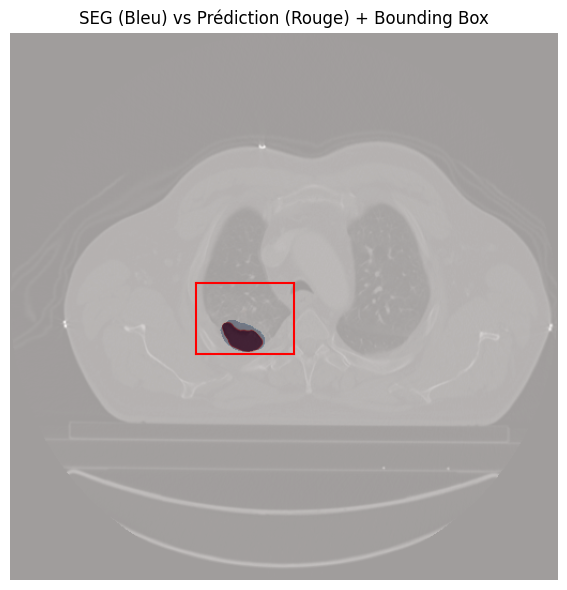

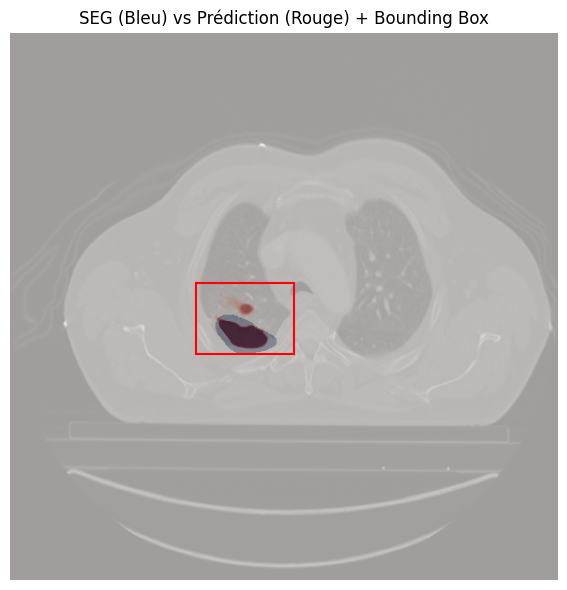

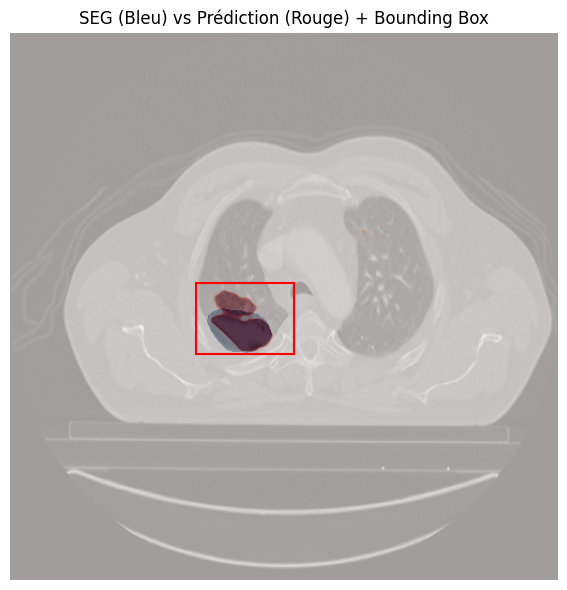

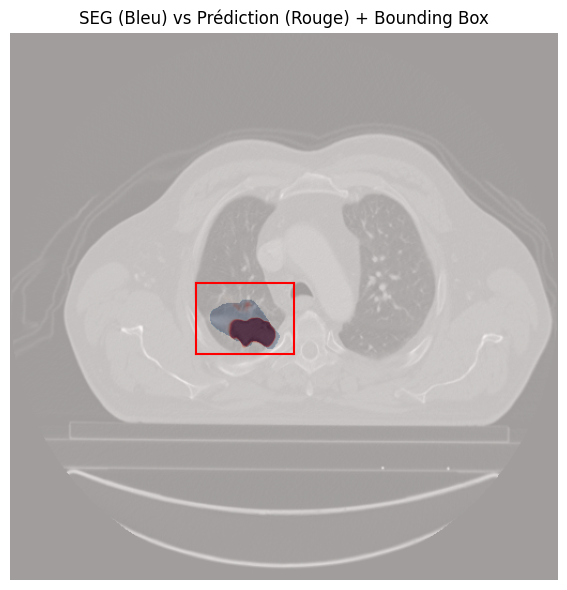

...

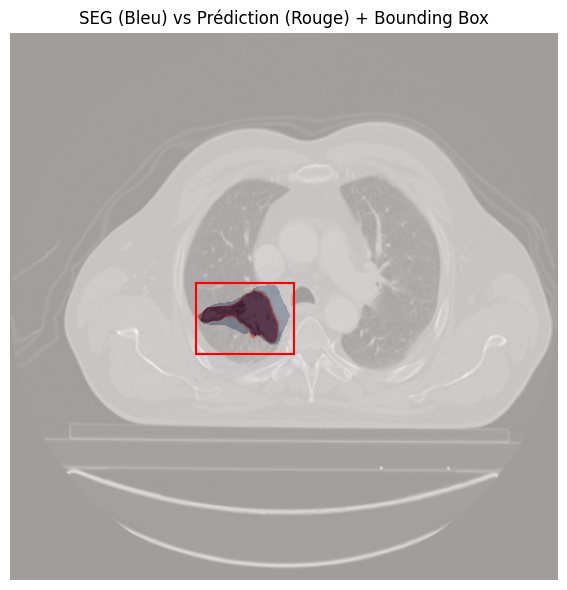

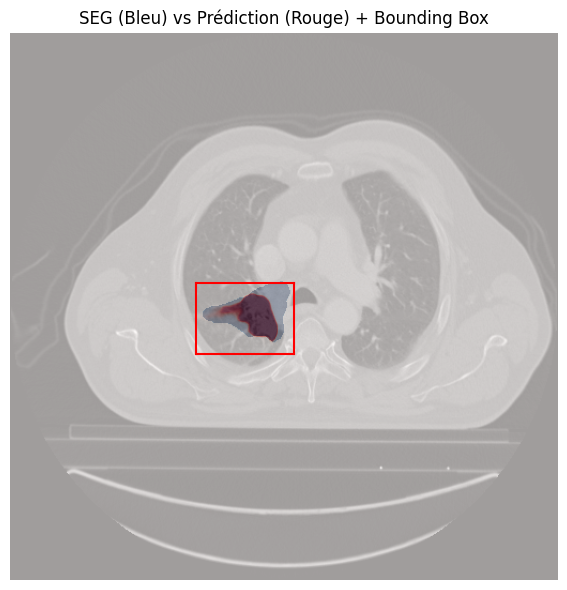

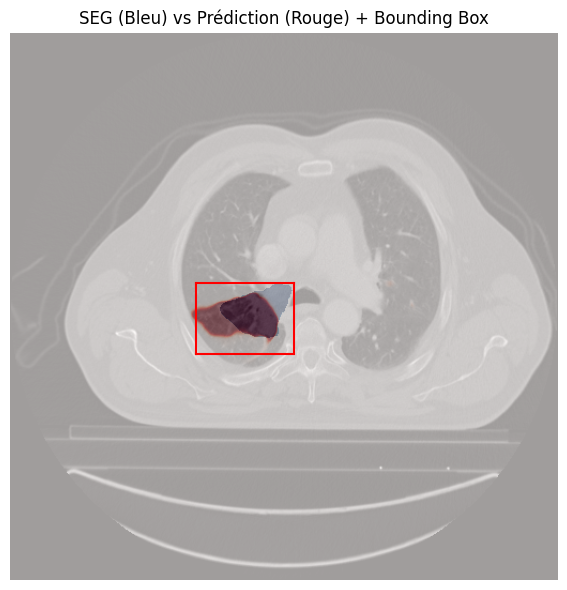

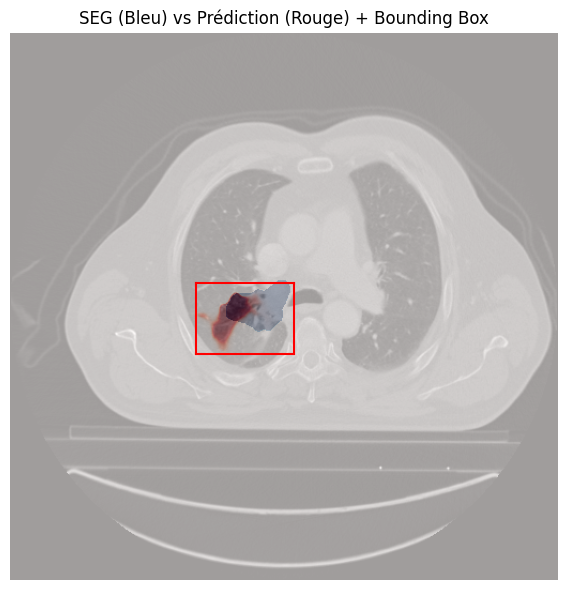

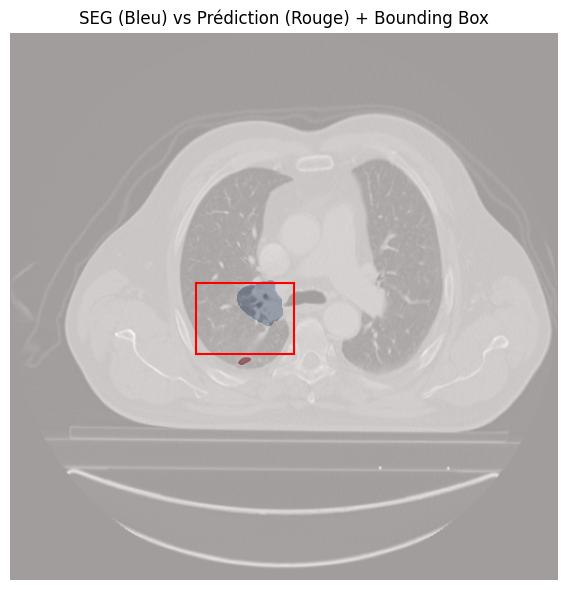

[[array([[-1024, -1024, -1024, ..., -1024, -1024, -1024],
         [-1024, -1024, -1024, ..., -1024, -1024, -1024],
         [-1024, -1024, -1024, ..., -1024, -1024, -1024],
         ...,
         [-1024, -1024, -1024, ..., -1024, -1024, -1024],
         [-1024, -1024, -1024, ..., -1024, -1024, -1024],
         [-1024, -1024, -1024, ..., -1024, -1024, -1024]], dtype=int16),
  array([[1.97989635e-07, 4.69208565e-08, 1.47998974e-10, ...,
          3.03989669e-16, 1.21900306e-13, 1.09235425e-11],
         [5.77473216e-08, 1.19963133e-08, 2.23413926e-11, ...,
          1.98766604e-17, 1.81984876e-14, 3.02903340e-12],
         [4.17917340e-10, 5.12596840e-11, 1.16015367e-14, ...,
          3.63310938e-22, 9.03975316e-18, 1.79087973e-14],
         ...,
         [3.25262536e-15, 1.57040186e-16, 8.53331920e-22, ...,
          3.55431796e-27, 1.35503857e-21, 2.07897570e-17],
         [1.83802171e-12, 1.91848179e-13, 2.27712384e-17, ...,
          8.90767093e-22, 1.29345819e-17, 1.71096962e-14],

In [12]:
import numpy as np
import matplotlib.pyplot as plt

segMasks = []

for i in range(len(masks)):
    binary_mask = (masks[i][1] > 0.5).astype(np.uint8)
    segMasks.append(binary_mask)

weightedMask = np.sum(segMasks, axis=0) / len(segMasks)

xb, yb = 0, 0

for i in range(len(weightedMask)):
    for j in range(len(weightedMask[0])):
        xb += weightedMask[i][j] * j
        yb += weightedMask[i][j] * i

xb = xb / np.sum(weightedMask)
yb = yb / np.sum(weightedMask)

strong = (weightedMask > np.max(weightedMask)/10).astype(np.uint8) 

limx = int(np.minimum(len(weightedMask) - xb, xb))
limy = int(np.minimum(len(weightedMask) - yb, yb))
intxb, intyb = int(xb), int(yb)
# x1
x1 = 0
for p in range(limx):
    lst = []
    for y in range(len(strong)):
        if strong[y][intxb-p] == 1:
            lst.append((y, xb-p))
    if len(lst) == 0:
        x1 = xb-p
        break 

# x2
x2 = 0
for p in range(limx):
    lst = []
    for y in range(len(strong)):
        if strong[y][intxb+p] == 1:
            lst.append((y, xb-p))
    if len(lst) == 0:
        x2 = xb+p
        break 

# y1
y1 = 0
for p in range(limy):
    lst = []
    for x in range(len(strong[0])):
        if strong[intyb-p][x] == 1:
            lst.append((intyb, x))
    if len(lst) == 0:
        y1 = yb-p
        break 

# y2
y2 = 0
for p in range(limy):
    lst = []
    for x in range(len(strong[0])):
        if strong[intyb+p][x] == 1:
            lst.append((intyb, x))
    if len(lst) == 0:
        y2 = yb+p
        break 

# dx = xb - (x1 + x2) / 2
# dy = yb - (y1 + y2) / 2

# x1 += dx
# x2 += dx
# y1 += dy
# y2 += dy

vect = (x1, x2, y1, y2)

call.showBoundingBox(patient, model, vect)

## Évaluation sur tous les patients

In [1]:
import G_inferenceCall as call
import pandas as pd
import numpy as np
import os

model = call.getModel()

[SRV-ML03:747074] shmem: mmap: an error occurred while determining whether or not /tmp/ompi.SRV-ML03.476685808/jf.0/3175350272/shared_mem_cuda_pool.SRV-ML03 could be created.
[SRV-ML03:747074] create_and_attach: unable to create shared memory BTL coordinating structure :: size 134217728 
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/kornia/feature/lightglue.py:30: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(


Deformable Transformer Encoder is not available.
➡️  Type de tokenizer : clip
➡️  Chemin/tokenizer utilisé : ./local-tokenizer/clip-vit-base-patch32
➡️  Contenu complet config_encoder : {'ARCH': 'vlpencoder', 'NAME': 'transformer', 'TOKENIZER': 'clip', 'PRETRAINED_TOKENIZER': './local-tokenizer/clip-vit-base-patch32', 'CONTEXT_LENGTH': 77, 'WIDTH': 512, 'HEADS': 8, 'LAYERS': 12, 'AUTOGRESSIVE': True}
✅ Tokenizer FINAL utilisé: ./local-tokenizer/clip-vit-base-patch32


/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/utils/generic.py:311: FutureWarning: `torch.utils._pytree._register_pytree_node` is deprecated. Please use `torch.utils._pytree.register_pytree_node` instead.
  torch.utils._pytree._register_pytree_node(
/home/gurrisi@clb.loc/anaconda3/envs/biomedparse/lib/python3.9/site-packages/transformers/modeling_utils.py:484: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explici

In [ ]:
#masks = call.getMasks(model)

In [ ]:
# np.save("masks.npy", np.array(masks, dtype=object), allow_pickle=True)


In [2]:
masks = np.load("masks.npy", allow_pickle=True)

Nombre de cas où ça n'a pas du tout fonctionné : 492
Proportion d'anglobement moyen par patient pour les autre cas : 0.8948019925646392
Proportion d'anglobement moyen : 0.594996557001177


/tmp/ipykernel_255741/3790510530.py:129: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([prop, propOk], labels=['Tous les cas', 'Cas réussis (>0)'])


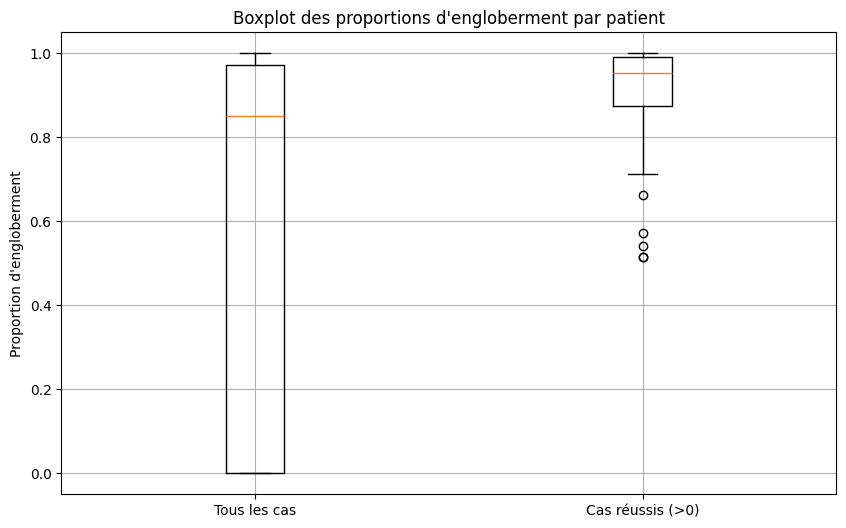

In [3]:
# masks = predicted_masks, ground_truth_masks
# print(len(masks[0][0]) == len(os.listdir('test/dcm/0/0/'))) => True 
import matplotlib.pyplot as plt

def isInBB(bb,coord):
    x1,x2,y1,y2 = bb 
    l,c = coord

    if l > y1 and c > x1 and c < x2 and l < y2 :
        return True
    
    return False

prop = []
propOk = []
z = []
for i in range(len(masks[0])):

    fltMasks = call.maskFilter(masks[0][i])
    
    segMasks = []

    for j in range(len(fltMasks)):
        binary_mask = (fltMasks[j] > 0.5).astype(np.uint8)
        segMasks.append(binary_mask)

    weightedMask = np.sum(segMasks, axis=0) / len(segMasks)
    
    xb, yb = 0, 0

    for k in range(len(weightedMask)):
        for j in range(len(weightedMask[0])):
            xb += weightedMask[k][j] * j
            yb += weightedMask[k][j] * k

    xb = xb / np.sum(weightedMask)
    yb = yb / np.sum(weightedMask)

    strong = (weightedMask > np.max(weightedMask)/10).astype(np.uint8) 

    limx = int(np.minimum(len(weightedMask) - xb, xb))
    limy = int(np.minimum(len(weightedMask) - yb, yb))
    intxb, intyb = int(xb), int(yb)

    # x1
    x1 = 0
    for p in range(limx):
        lst = []
        for y in range(len(strong)):
            if strong[y][intxb-p] == 1:
                lst.append((y, xb-p))
        if len(lst) == 0:
            x1 = xb-p
            break 

    # x2
    x2 = 0
    for p in range(limx):
        lst = []
        for y in range(len(strong)):
            if strong[y][intxb+p] == 1:
                lst.append((y, xb-p))
        if len(lst) == 0:
            x2 = xb+p
            break 

    # y1
    y1 = 0
    for p in range(limy):
        lst = []
        for x in range(len(strong[0])):
            if strong[intyb-p][x] == 1:
                lst.append((intyb, x))
        if len(lst) == 0:
            y1 = yb-p
            break 

    # y2
    y2 = 0
    for p in range(limy):
        lst = []
        for x in range(len(strong[0])):
            if strong[intyb+p][x] == 1:
                lst.append((intyb, x))
        if len(lst) == 0:
            y2 = yb+p
            break 

    dx = xb - (x1 + x2) / 2
    dy = yb - (y1 + y2) / 2


    bb = x1,x2,y1,y2

    # on a obtenu la BoundingBox. On va maintenant parcourir tous les pixels de tous les masques gt et vérifier s'ils sont dans la BB.
    # on va calculer la proportion de pixel dans la bounding box et faire une moyenne par patient et on affichera le résultat avec un box plot.

    propPat = []
    propPatOk = []
    for j in range(len(masks[1][i])) :
        # print(len(masks[1][i][0]))
        # print(f"{j} : {masks[1][i][j]}")
        maskGt = masks[1][i][j]
        tot = 0
        c = 0
        for y in range(len(maskGt)):
            for x in range(len(maskGt[0])):
                if maskGt[y][x] == 1 :
                    tot+=1
                    if isInBB(bb, (y,x)) :
                        c+=1
        if tot == 0:
            tot=1
        pp = c/tot
        if pp == 0:
            bbn=True
            if x2-x1 > 5 or y2-y1 > 5 :
                bbn=False
            z.append([i, (x1, x2, y1, y2), bbn, masks[0][i], masks[1][i]])
        else:
            propPatOk.append(pp)
        propPat.append(pp)
    prop.append(np.mean(propPat))
    if propPatOk : propOk.append(np.mean(propPatOk))
print(f"Nombre de cas où ça n'a pas du tout fonctionné : {len(z)}")
print(f"Proportion d'anglobement moyen par patient pour les autre cas : {np.mean(propOk)}")
print(f"Proportion d'anglobement moyen : {np.mean(prop)}")
plt.figure(figsize=(10, 6))
plt.boxplot([prop, propOk], labels=['Tous les cas', 'Cas réussis (>0)'])
plt.ylabel("Proportion d'engloberment")
plt.title("Boxplot des proportions d'engloberment par patient")
plt.grid(True)
plt.show()


# Avant filtrage :
# Nombre de cas où ça n'a pas du tout fonctionné : 482
# Proportion d'anglobement moyen par patient pour les autre cas : 0.8777389413907586
# Proportion d'anglobement moyen : 0.5957957394628821        



Nb de patients avec bbox fine (stockés dans z) : 11
Moyenne (toutes images) : 0.5950
Moyenne (images dont la bbox patient est épaisse) : 0.7209


/tmp/ipykernel_283665/22945297.py:107: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


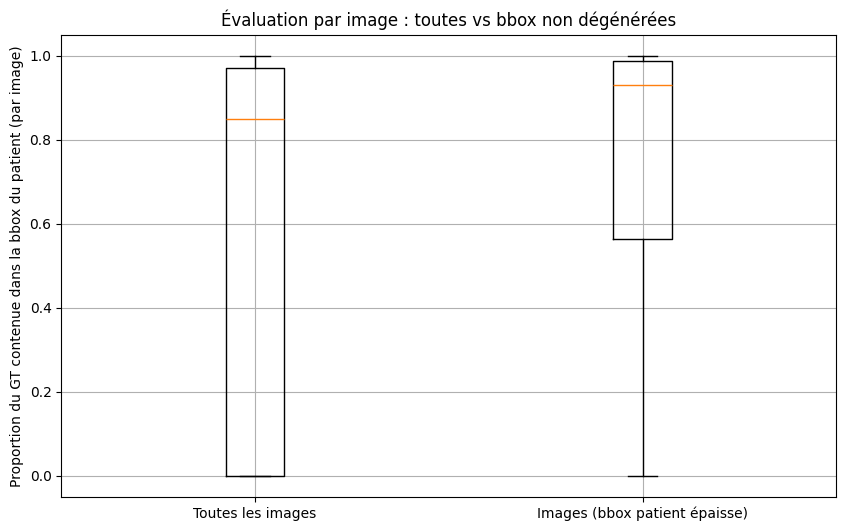

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def isInBB(bb, coord):
    x1, x2, y1, y2 = bb
    l, c = coord
    return (l > y1) and (c > x1) and (c < x2) and (l < y2)

pp_all   = []  # proportions (GT dans bbox) pour toutes les images
pp_thick = []  # idem mais seulement si la bbox du patient est "épaisse" (non fine)

z = []  

for i in range(len(masks[0])):

    fltMasks = call.maskFilter(masks[0][i])              
    segMasks = (np.asarray(fltMasks) > 0.5).astype(np.uint8)
    weightedMask = segMasks.mean(axis=0)                

    H, W = weightedMask.shape
    yy, xx = np.indices((H, W))

    s  = weightedMask.sum() or 1.0
    xb = (weightedMask * xx).sum() / s
    yb = (weightedMask * yy).sum() / s

    mx     = weightedMask.max()
    strong = (weightedMask > (mx / 10))

    intxb, intyb = int(xb), int(yb)
    limx = int(min(W - xb, xb))
    limy = int(min(H - yb, yb))

    # x1
    x1 = 0
    for p in range(limx):
        lst = []
        for y in range(H):
            if strong[y][intxb - p] == 1:
                lst.append((y, xb - p))
        if len(lst) == 0:
            x1 = xb - p
            break

    # x2
    x2 = 0
    for p in range(limx):
        lst = []
        for y in range(H):
            if strong[y][intxb + p] == 1:
                lst.append((y, xb - p))
        if len(lst) == 0:
            x2 = xb + p
            break

    # y1
    y1 = 0
    for p in range(limy):
        lst = []
        for x in range(W):
            if strong[intyb - p][x] == 1:
                lst.append((intyb, x))
        if len(lst) == 0:
            y1 = yb - p
            break

    # y2
    y2 = 0
    for p in range(limy):
        lst = []
        for x in range(W):
            if strong[intyb + p][x] == 1:
                lst.append((intyb, x))
        if len(lst) == 0:
            y2 = yb + p
            break

    bb = (x1, x2, y1, y2)

    is_thick = (x2 - x1 >= 2) and (y2 - y1 >= 2)

    gt_stack = np.asarray(masks[1][i])      
    gt_bool = (gt_stack != 0)               # True sur les pixels positifs du GT

    inside_mask = (xx > x1) & (xx < x2) & (yy > y1) & (yy < y2)  

    totals = np.count_nonzero(gt_bool, axis=(1, 2))
    inside_counts = np.count_nonzero(gt_bool & inside_mask[None, :, :], axis=(1, 2))
    den = np.where(totals == 0, 1, totals)
    pp_i = inside_counts / den
    pp_all.append( np.mean(pp_i))

    if is_thick:
        pp_thick.append( np.mean(pp_i))
    else:
        if [i, bb, masks[0][i], masks[1][i]] not in z:
            z.append([i, bb, masks[0][i], masks[1][i]])

print(f"Nb de patients avec bbox fine (stockés dans z) : {len(z)}")
print(f"Moyenne (toutes images) : {np.mean(pp_all):.4f}")
if len(pp_thick) > 0:
    print(f"Moyenne (images dont la bbox patient est épaisse) : {np.mean(pp_thick):.4f}")
else:
    print("Aucune bbox 'épaisse' détectée selon le critère (>=2 px en largeur ET hauteur).")

plt.figure(figsize=(10, 6))
plt.boxplot(
    [pp_all, pp_thick],
    labels=['Toutes les images', 'Images (bbox patient épaisse)']
)
plt.ylabel("Proportion du GT contenue dans la bbox du patient (par image)")
plt.title("Évaluation par image : toutes vs bbox non dégénérées")
plt.grid(True)
plt.show()


### On va vérifier si le résultat est mieux sur uniquement les images filtrées

Nb de patients avec bbox fine (stockés dans z) : 11
Moyenne (toutes images) : 0.6126
Moyenne (images dont la bbox patient est épaisse) : 0.7422


/tmp/ipykernel_747074/1395039489.py:115: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


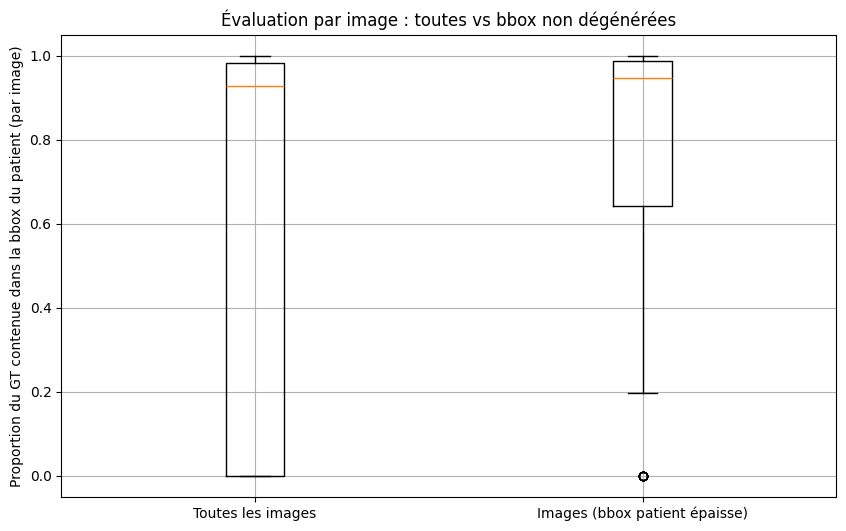

In [4]:
import numpy as np
import matplotlib.pyplot as plt

def isInBB(bb, coord):
    x1, x2, y1, y2 = bb
    l, c = coord
    return (l > y1) and (c > x1) and (c < x2) and (l < y2)

pp_all   = []
pp_thick = []
z = []

for i in range(len(masks[0])):

    preds_i = np.asarray(masks[0][i])
    gts_i   = np.asarray(masks[1][i])
    preds_f, gts_f = call.maskFilterGT([preds_i, gts_i])

    preds_f = np.asarray(preds_f)
    gts_f   = np.asarray(gts_f)

    if preds_f.size == 0 or preds_f.ndim != 3:
        continue

    segMasks = (preds_f > 0.5).astype(np.uint8)   
    weightedMask = segMasks.mean(axis=0)          

    H, W = weightedMask.shape
    yy, xx = np.indices((H, W))

    s  = weightedMask.sum() or 1.0
    xb = (weightedMask * xx).sum() / s
    yb = (weightedMask * yy).sum() / s

    mx     = weightedMask.max()
    strong = (weightedMask > (mx / 10))

    intxb, intyb = int(xb), int(yb)
    limx = int(min(W - xb, xb))
    limy = int(min(H - yb, yb))

    # x1
    x1 = 0
    for p in range(limx):
        lst = []
        for y in range(H):
            if strong[y][intxb - p] == 1:
                lst.append((y, xb - p))
        if len(lst) == 0:
            x1 = xb - p
            break

    # x2
    x2 = 0
    for p in range(limx):
        lst = []
        for y in range(H):
            if strong[y][intxb + p] == 1:
                lst.append((y, xb - p))
        if len(lst) == 0:
            x2 = xb + p
            break

    # y1
    y1 = 0
    for p in range(limy):
        lst = []
        for x in range(W):
            if strong[intyb - p][x] == 1:
                lst.append((intyb, x))
        if len(lst) == 0:
            y1 = yb - p
            break

    # y2
    y2 = 0
    for p in range(limy):
        lst = []
        for x in range(W):
            if strong[intyb + p][x] == 1:
                lst.append((intyb, x))
        if len(lst) == 0:
            y2 = yb + p
            break

    bb = (x1, x2, y1, y2)
    is_thick = (x2 - x1 >= 2) and (y2 - y1 >= 2)

    gt_stack = np.asarray(gts_f)                 
    gt_bool  = (gt_stack != 0)

    inside_mask = (xx > x1) & (xx < x2) & (yy > y1) & (yy < y2)  

    totals        = np.count_nonzero(gt_bool, axis=(1, 2))
    inside_counts = np.count_nonzero(gt_bool & inside_mask[None, :, :], axis=(1, 2))
    den = np.where(totals == 0, 1, totals)       
    pp_i = inside_counts / den                   

    pp_all.append(np.mean(pp_i))
    if is_thick:
        pp_thick.append(np.mean(pp_i))
    else:
        item = [i, bb, preds_f, gts_f]
        if item not in z:
            z.append(item)

print(f"Nb de patients avec bbox fine (stockés dans z) : {len(z)}")
print(f"Moyenne (toutes images) : {np.mean(pp_all):.4f}")
if len(pp_thick) > 0:
    print(f"Moyenne (images dont la bbox patient est épaisse) : {np.mean(pp_thick):.4f}")
else:
    print("Aucune bbox 'épaisse' détectée selon le critère (>=2 px en largeur ET hauteur).")

plt.figure(figsize=(10, 6))
plt.boxplot(
    [pp_all, pp_thick if len(pp_thick) > 0 else [np.nan]],
    labels=['Toutes les images', 'Images (bbox patient épaisse)']
)
plt.ylabel("Proportion du GT contenue dans la bbox du patient (par image)")
plt.title("Évaluation par image : toutes vs bbox non dégénérées")
plt.grid(True)
plt.show()


### Amélioration de l'algo

Nombre de contours: 6


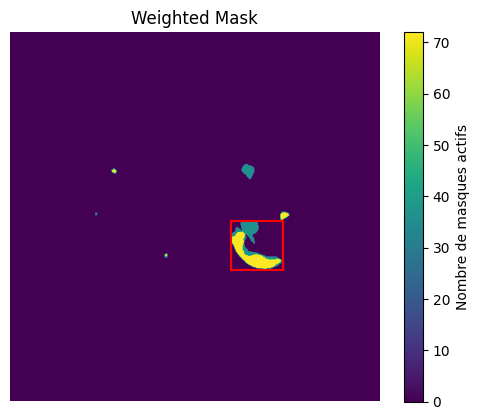

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import random as rd
import cv2

pp_all   = []
pp_thick = []
z = []

# i = rd.randint(0,len(masks[0]))
# print(i)
i=8

preds_i = np.asarray(masks[0][i])
gts_i   = np.asarray(masks[1][i])
preds_f, gts_f = call.maskFilterGT([preds_i, gts_i])

preds_f = np.asarray(preds_f)
gts_f   = np.asarray(gts_f)


segMasks = (preds_f > 0.5).astype(np.uint8)   
weightedMask = segMasks.mean(axis=0)      
  
cvrtWeightedMask = (weightedMask * 255).astype(np.uint8)

contours, _ = cv2.findContours(cvrtWeightedMask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

coords = []

for cnt in contours:
    x1, y1, w, h = cv2.boundingRect(cnt)
    coords.append((x1,y1,x1 + w,y1 + h))

print(f"Nombre de contours: {len(contours)}")  
s = []
for (x1, y1, x2, y2) in coords:
    s.append(np.sum(weightedMask[y1+1:y2, x1+1:x2]))
zone = int(np.argmax(s))


(x1, y1, x2, y2) =  coords[zone]
plt.plot([x1, x1], [y1, y2], 'r')  # gauche
plt.plot([x2, x2], [y1, y2], 'r')  # droit
plt.plot([x1, x2], [y1, y1], 'r')  # haut
plt.plot([x1, x2], [y2, y2], 'r')  # bas        
plt.imshow(cvrtWeightedMask)
plt.colorbar(label='Nombre de masques actifs')
plt.title('Weighted Mask')
plt.axis('off') 
plt.show()



<p>Test :</p>

Nb de patients avec bbox fine (stockés dans z) : 0
Moyenne (toutes images) : 0.6225
Moyenne (images dont la bbox patient est épaisse) : 0.6225


/tmp/ipykernel_747074/2191727449.py:72: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(


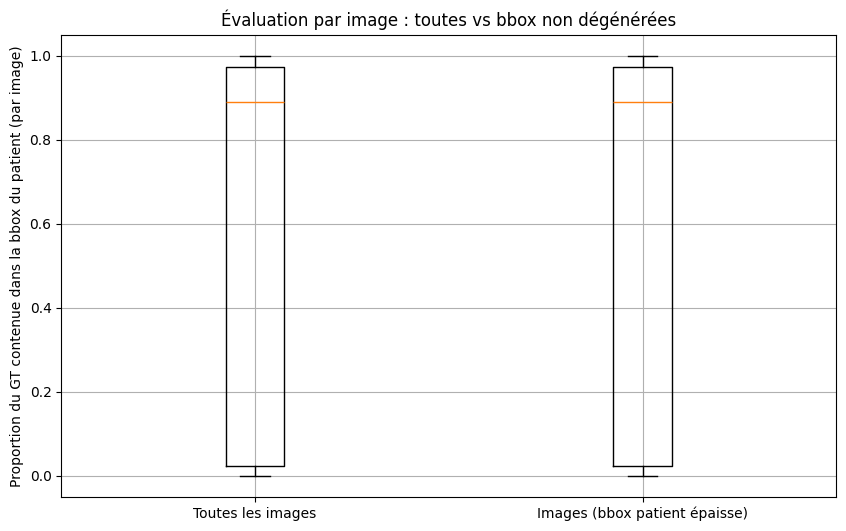

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

pp_all   = []
pp_thick = []
z = []

for i in range(len(masks[0])):

    preds_i = np.asarray(masks[0][i])
    gts_i   = np.asarray(masks[1][i])
    preds_f, gts_f = call.maskFilterGT([preds_i, gts_i])

    preds_f = np.asarray(preds_f)
    gts_f   = np.asarray(gts_f)

    segMasks = (preds_f > 0.5).astype(np.uint8)   
    weightedMask = segMasks.mean(axis=0)          

    cvrtWeightedMask = (weightedMask * 255).astype(np.uint8)

    contours, _ = cv2.findContours(cvrtWeightedMask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    coords = []

    for cnt in contours:
        x1, y1, w, h = cv2.boundingRect(cnt)
        coords.append((x1,y1,x1 + w,y1 + h))

    s = []
    for (x1, y1, x2, y2) in coords:
        s.append(np.sum(weightedMask[y1+1:y2, x1+1:x2]))
    zone = int(np.argmax(s))

    bb = coords[zone]
    x1, y1, x2, y2 = bb
    is_thick = (x2 - x1 >= 2) and (y2 - y1 >= 2)

    gt_stack = np.asarray(gts_f)                 
    gt_bool  = (gt_stack != 0)

    H, W = weightedMask.shape
    yy, xx = np.indices((H, W)) 
    inside_mask = (xx > x1) & (xx < x2) & (yy > y1) & (yy < y2)  

    totals = np.count_nonzero(gt_bool, axis=(1, 2))
    inside_counts = np.count_nonzero(gt_bool & inside_mask[None, :, :], axis=(1, 2))
    den = np.where(totals == 0, 1, totals)       
    pp_i = inside_counts / den                   

    pp_all.append(np.mean(pp_i))
    if is_thick:
        pp_thick.append(np.mean(pp_i))
    else:
        item = [i, bb, preds_f, gts_f]
        if item not in z:
            z.append(item)

print(f"Nb de patients avec bbox fine (stockés dans z) : {len(z)}")
print(f"Moyenne (toutes images) : {np.mean(pp_all):.4f}")
if len(pp_thick) > 0:
    print(f"Moyenne (images dont la bbox patient est épaisse) : {np.mean(pp_thick):.4f}")
else:
    print("Aucune bbox 'épaisse' détectée selon le critère (>=2 px en largeur ET hauteur).")

plt.figure(figsize=(10, 6))
plt.boxplot(
    [pp_all, pp_thick if len(pp_thick) > 0 else [np.nan]],
    labels=['Toutes les images', 'Images (bbox patient épaisse)']
)
plt.ylabel("Proportion du GT contenue dans la bbox du patient (par image)")
plt.title("Évaluation par image : toutes vs bbox non dégénérées")
plt.grid(True)
plt.show()
